Import libraries

In [1]:
import tensorflow as tf
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
import json
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import matplotlib.pyplot as plt
import seaborn as sns

load data

In [2]:
df =pd.read_csv("../cervical-cancer_csv.csv")

Data information,preparation

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 835 entries, 0 to 834
Data columns (total 36 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Age                                 835 non-null    int64  
 1   Number of sexual partners           810 non-null    float64
 2   First sexual intercourse            828 non-null    float64
 3   Num of pregnancies                  779 non-null    float64
 4   Smokes                              822 non-null    float64
 5   Smokes (years)                      822 non-null    float64
 6   Smokes (packs/year)                 822 non-null    float64
 7   Hormonal Contraceptives             732 non-null    float64
 8   Hormonal Contraceptives (years)     732 non-null    float64
 9   IUD                                 723 non-null    float64
 10  IUD (years)                         723 non-null    float64
 11  STDs                                735 non-n

In [4]:
df.describe()

,Age,Number of sexual partners,First sexual intercourse,Num of pregnancies,Smokes,Smokes (years),Smokes (packs/year),Hormonal Contraceptives,Hormonal Contraceptives (years),IUD,...,STDs: Time since first diagnosis,STDs: Time since last diagnosis,Dx:Cancer,Dx:CIN,Dx:HPV,Dx,Hinselmann,Schiller,Citology,Biopsy
count,835.000000,810.000000,828.000000,779.000000,822.000000,822.000000,822.000000,732.000000,732.000000,723.000000,...,71.000000,71.000000,835.000000,835.000000,835.000000,835.000000,835.000000,835.000000,835.000000,835.000000
mean,27.023952,2.551852,17.020531,2.304236,0.149635,1.253850,0.465823,0.651639,2.302916,0.114799,...,6.140845,5.816901,0.021557,0.010778,0.021557,0.028743,0.041916,0.087425,0.051497,0.064671
std,8.482986,1.676686,2.817000,1.455817,0.356930,4.140727,2.256273,0.476777,3.794180,0.319000,...,5.895024,5.755271,0.145319,0.103320,0.145319,0.167182,0.200518,0.282626,0.221142,0.246091
min,13.000000,1.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,21.000000,2.000000,15.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,26.000000,2.000000,17.000000,2.000000,0.000000,0.000000,0.000000,1.000000,0.500000,0.000000,...,4.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,32.000000,3.000000,18.000000,3.000000,0.000000,0.000000,0.000000,1.000000,3.000000,0.000000,...,8.000000,7.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,84.000000,28.000000,32.000000,11.000000,1.000000,37.000000,37.000000,1.000000,30.000000,1.000000,...,22.000000,22.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [5]:
missing_values=df.isnull().sum()
print(f"Missing entries: {missing_values}")

Missing entries: Age                                     0
Number of sexual partners              25
First sexual intercourse                7
Num of pregnancies                     56
Smokes                                 13
Smokes (years)                         13
Smokes (packs/year)                    13
Hormonal Contraceptives               103
Hormonal Contraceptives (years)       103
IUD                                   112
IUD (years)                           112
STDs                                  100
STDs (number)                         100
STDs:condylomatosis                   100
STDs:cervical condylomatosis          100
STDs:vaginal condylomatosis           100
STDs:vulvo-perineal condylomatosis    100
STDs:syphilis                         100
STDs:pelvic inflammatory disease      100
STDs:genital herpes                   100
STDs:molluscum contagiosum            100
STDs:AIDS                             100
STDs:HIV                              100
STDs:Hepatitis B 

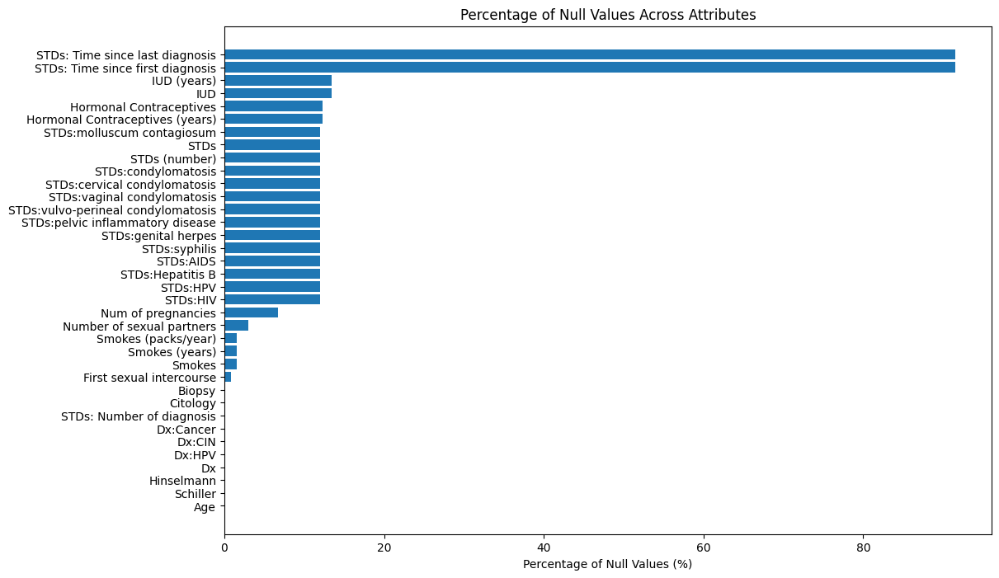

In [6]:
null_percentage = df.isnull().mean() * 100

# Sort the values in ascending order
sorted_idx = np.argsort(null_percentage)

# Plotting
plt.figure(figsize=(12, 8))
plt.barh(range(len(sorted_idx)), null_percentage.iloc[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), df.columns[sorted_idx])
plt.xlabel("Percentage of Null Values (%)")
plt.title("Percentage of Null Values Across Attributes")
plt.show()

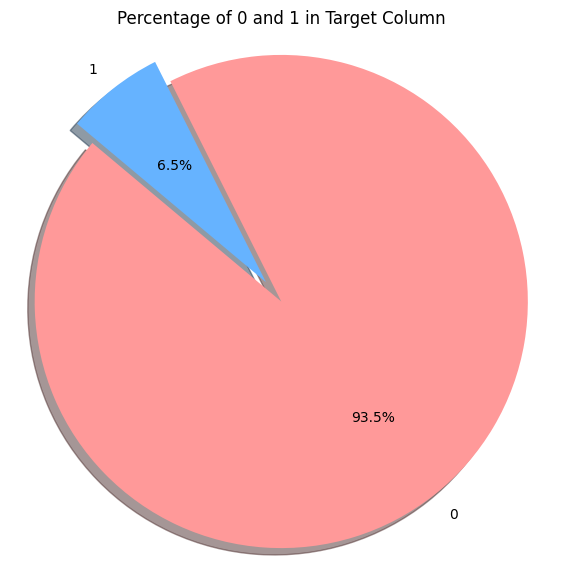

In [7]:
target_counts = df['Biopsy'].value_counts()

# Calculate the percentages for each value
labels = ['0', '1']
sizes = target_counts.values
colors = ['#ff9999','#66b3ff']
explode = (0.1, 0)  # explode the first slice

# Create the pie chart
plt.figure(figsize=(7, 7))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140)
plt.title('Percentage of 0 and 1 in Target Column')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Display the plot
plt.show()

In [8]:
df.head()

,Age,Number of sexual partners,First sexual intercourse,Num of pregnancies,Smokes,Smokes (years),Smokes (packs/year),Hormonal Contraceptives,Hormonal Contraceptives (years),IUD,...,STDs: Time since first diagnosis,STDs: Time since last diagnosis,Dx:Cancer,Dx:CIN,Dx:HPV,Dx,Hinselmann,Schiller,Citology,Biopsy
0,18,4.0,15.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,0,0,0,0,0,0,0,0
1,15,1.0,14.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,0,0,0,0,0,0,0,0
2,34,1.0,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,0,0,0,0,0,0,0,0
3,52,5.0,16.0,4.0,1.0,37.0,37.0,1.0,3.0,0.0,...,NaN,NaN,1,0,1,0,0,0,0,0
4,46,3.0,21.0,4.0,0.0,0.0,0.0,1.0,15.0,0.0,...,NaN,NaN,0,0,0,0,0,0,0,0


In [9]:
df.tail()

,Age,Number of sexual partners,First sexual intercourse,Num of pregnancies,Smokes,Smokes (years),Smokes (packs/year),Hormonal Contraceptives,Hormonal Contraceptives (years),IUD,...,STDs: Time since first diagnosis,STDs: Time since last diagnosis,Dx:Cancer,Dx:CIN,Dx:HPV,Dx,Hinselmann,Schiller,Citology,Biopsy
830,34,3.0,18.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,...,NaN,NaN,0,0,0,0,0,0,0,0
831,32,2.0,19.0,1.0,0.0,0.0,0.0,1.0,8.00,0.0,...,NaN,NaN,0,0,0,0,0,0,0,0
832,25,2.0,17.0,0.0,0.0,0.0,0.0,1.0,0.08,0.0,...,NaN,NaN,0,0,0,0,0,0,1,0
833,33,2.0,24.0,2.0,0.0,0.0,0.0,1.0,0.08,0.0,...,NaN,NaN,0,0,0,0,0,0,0,0
834,29,2.0,20.0,1.0,0.0,0.0,0.0,1.0,0.50,0.0,...,NaN,NaN,0,0,0,0,0,0,0,0


In [10]:
shape=df.shape
print(f"Shape: {shape}")

Shape: (835, 36)


In [11]:
columns=df.columns
print(f"columns: {columns}")

columns: Index(['Age', 'Number of sexual partners', 'First sexual intercourse',
       'Num of pregnancies', 'Smokes', 'Smokes (years)', 'Smokes (packs/year)',
       'Hormonal Contraceptives', 'Hormonal Contraceptives (years)', 'IUD',
       'IUD (years)', 'STDs', 'STDs (number)', 'STDs:condylomatosis',
       'STDs:cervical condylomatosis', 'STDs:vaginal condylomatosis',
       'STDs:vulvo-perineal condylomatosis', 'STDs:syphilis',
       'STDs:pelvic inflammatory disease', 'STDs:genital herpes',
       'STDs:molluscum contagiosum', 'STDs:AIDS', 'STDs:HIV',
       'STDs:Hepatitis B', 'STDs:HPV', 'STDs: Number of diagnosis',
       'STDs: Time since first diagnosis', 'STDs: Time since last diagnosis',
       'Dx:Cancer', 'Dx:CIN', 'Dx:HPV', 'Dx', 'Hinselmann', 'Schiller',
       'Citology', 'Biopsy'],
      dtype='object')


In [12]:
datatypes=df.dtypes
print(datatypes)

Age                                     int64
Number of sexual partners             float64
First sexual intercourse              float64
Num of pregnancies                    float64
Smokes                                float64
Smokes (years)                        float64
Smokes (packs/year)                   float64
Hormonal Contraceptives               float64
Hormonal Contraceptives (years)       float64
IUD                                   float64
IUD (years)                           float64
STDs                                  float64
STDs (number)                         float64
STDs:condylomatosis                   float64
STDs:cervical condylomatosis          float64
STDs:vaginal condylomatosis           float64
STDs:vulvo-perineal condylomatosis    float64
STDs:syphilis                         float64
STDs:pelvic inflammatory disease      float64
STDs:genital herpes                   float64
STDs:molluscum contagiosum            float64
STDs:AIDS                         

In [13]:
duplicates=df.duplicated()
print(duplicates)


0      False
1      False
2      False
3      False
4      False
       ...  
830    False
831    False
832    False
833    False
834    False
Length: 835, dtype: bool


DATA CLEANING

 Remove Rows with Missing Target Values

In [14]:

df=df.dropna(subset=["Biopsy"])
df.shape

(835, 36)

 Impute Missing Values for Features

In [15]:
X = df.drop('Biopsy', axis=1,inplace=False)
y = df['Biopsy']

numeric_cols = X.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = X.select_dtypes(include=['object', 'bool']).columns

numeric_transformer = SimpleImputer(strategy='mean')
categorical_transformer = SimpleImputer(strategy='most_frequent')

# Create the ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_cols),
        ('cat', categorical_transformer, categorical_cols)
    ])

# Fit and transform the data
df = pd.DataFrame(preprocessor.fit_transform(X), columns=X.columns)
df=pd.concat([df, y.reset_index(drop=True)], axis=1)



In [16]:
# Remove duplicate rows
df = df.drop_duplicates()
df.drop(['STDs: Time since first diagnosis', 'STDs: Time since last diagnosis'], axis=1, inplace=True)
categorical_cols = df.select_dtypes(include=['object', 'bool']).columns

In [17]:
missing_values=df.isnull().sum()
print(f"Missing entries: {missing_values}")

Missing entries: Age                                   0
Number of sexual partners             0
First sexual intercourse              0
Num of pregnancies                    0
Smokes                                0
Smokes (years)                        0
Smokes (packs/year)                   0
Hormonal Contraceptives               0
Hormonal Contraceptives (years)       0
IUD                                   0
IUD (years)                           0
STDs                                  0
STDs (number)                         0
STDs:condylomatosis                   0
STDs:cervical condylomatosis          0
STDs:vaginal condylomatosis           0
STDs:vulvo-perineal condylomatosis    0
STDs:syphilis                         0
STDs:pelvic inflammatory disease      0
STDs:genital herpes                   0
STDs:molluscum contagiosum            0
STDs:AIDS                             0
STDs:HIV                              0
STDs:Hepatitis B                      0
STDs:HPV               

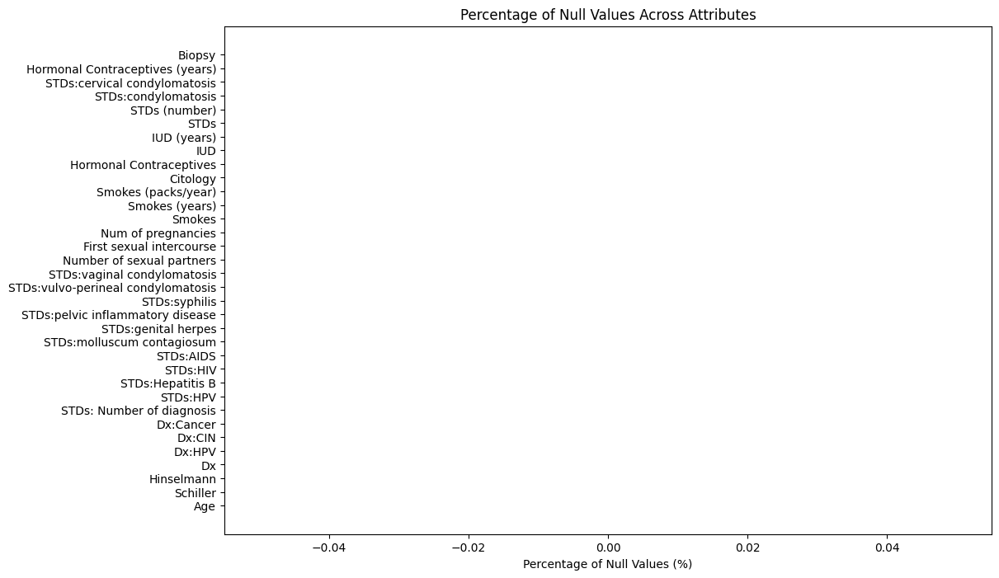

In [18]:
null_percentage = df.isnull().mean() * 100

# Sort the values in ascending order
sorted_idx = np.argsort(null_percentage)

# Plotting
plt.figure(figsize=(12, 8))
plt.barh(range(len(sorted_idx)), null_percentage.iloc[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), df.columns[sorted_idx])
plt.xlabel("Percentage of Null Values (%)")
plt.title("Percentage of Null Values Across Attributes")
plt.show()

To identify the columns with the highest chi-square values, we can use the Chi-Square Test of Independence. This statistical test is used to determine if there is a significant association between two categorical variables. It helps in feature selection by identifying variables that have a strong association with the target variable

In [19]:
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.preprocessing import LabelEncoder, Binarizer

target = 'Biopsy'
y = df[target]
y = LabelEncoder().fit_transform(y)  # Encode the target variable if not binary

# Select categorical or binned features for chi-square test
# For simplicity, assuming all features are categorical or have been binned appropriately
X = df.drop(columns=[target])

# Convert any numerical columns to categorical if necessary (example for 'Age')
# df['Age'] = pd.cut(df['Age'], bins=[10, 20, 30, 40, 50, 60, 70, 80], labels=False)

# If required, use LabelEncoder to encode categorical variables
X = X.apply(LabelEncoder().fit_transform)

# Apply SelectKBest with chi2 to find top features
chi2_selector = SelectKBest(chi2, k='all')
chi2_selector.fit(X, y)
chi2_scores = pd.DataFrame({
    'Feature': X.columns,
    'Chi2 Score': chi2_selector.scores_
})

# Sort by Chi2 Score
chi2_scores = chi2_scores.sort_values(by='Chi2 Score', ascending=False)

# Display the top features
print(chi2_scores)

                               Feature  Chi2 Score
31                            Schiller  404.814045
30                          Hinselmann  244.179030
32                            Citology   77.733404
6                  Smokes (packs/year)   57.501835
5                       Smokes (years)   33.231982
26                           Dx:Cancer   21.479063
28                              Dx:HPV   21.479063
29                                  Dx   20.444469
0                                  Age   14.377620
27                              Dx:CIN   10.739531
12                       STDs (number)   10.124247
25           STDs: Number of diagnosis    8.336329
17                       STDs:syphilis    5.612999
11                                STDs    5.559956
10                         IUD (years)    4.912309
15         STDs:vaginal condylomatosis    3.803081
24                            STDs:HPV    3.550063
18    STDs:pelvic inflammatory disease    3.424246
20          STDs:molluscum cont

Plotting for Cancer Diagnosis

In [20]:
bins = [0, 19, 29, 39, 49, 59, 69, 79]
labels = ['Teen', '20\'s', '30\'s', '40\'s', '50\'s', '60\'s', '70\'s']

# Categorize the 'Age' column
df['Age Category'] = pd.cut(df['Age'], bins=bins, labels=labels, right=True)

# Filter the dataset for cancer or HPV diagnosis
diagnosed_df = df[(df['Dx:Cancer'] == 1) | (df['Dx:HPV'] == 1)]

# Count the number of diagnoses in each age category
diagnosis_counts = diagnosed_df['Age Category'].value_counts().sort_index()

# Plot the pie chart
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99','#c2c2f0','#ffb3e6','#c2f0c2']

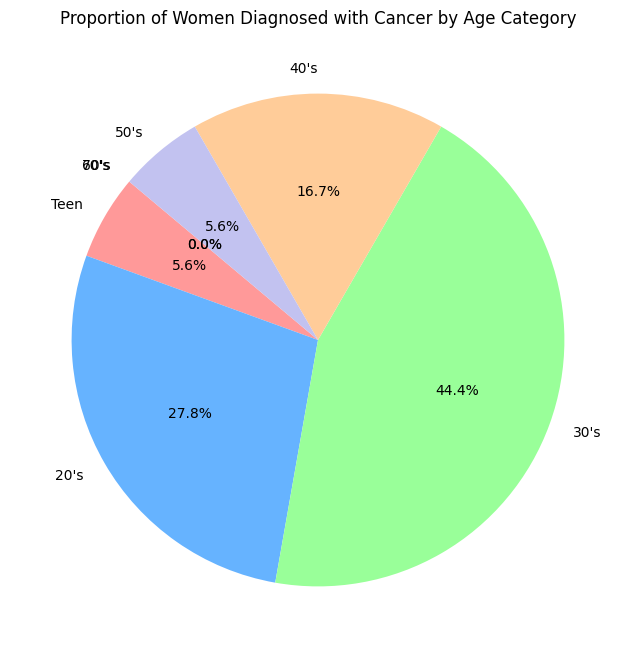

In [21]:
# Filter the dataset for cancer diagnosis
cancer_df = df[df['Dx:Cancer'] == 1]

# Count the number of cancer diagnoses in each age category
cancer_counts = cancer_df['Age Category'].value_counts().sort_index()
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99','#c2c2f0','#ffb3e6','#c2f0c2']
# Plot the pie chart for cancer diagnosis
plt.figure(figsize=(8, 8))
plt.pie(cancer_counts, labels=cancer_counts.index, colors=colors, autopct='%1.1f%%', startangle=140)
plt.title('Proportion of Women Diagnosed with Cancer by Age Category')
plt.show()


Plotting for HPV Diagnosis

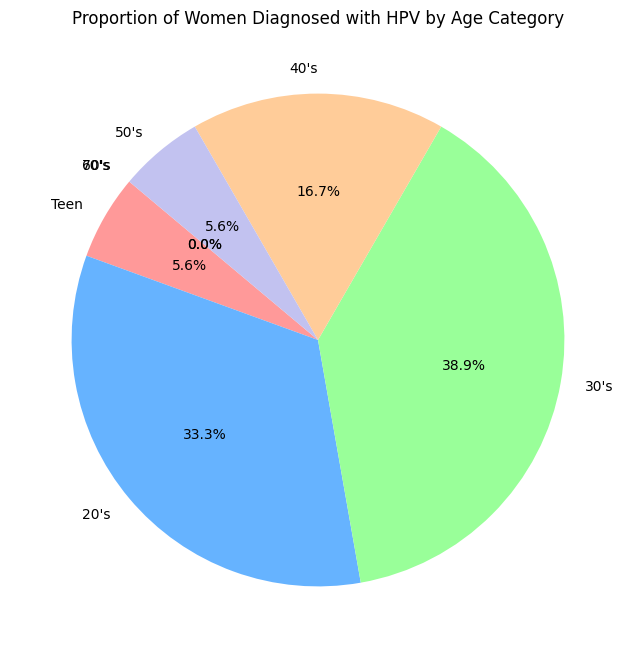

In [22]:
# Filter the dataset for HPV diagnosis
hpv_df = df[df['Dx:HPV'] == 1]

# Count the number of HPV diagnoses in each age category
hpv_counts = hpv_df['Age Category'].value_counts().sort_index()

# Plot the pie chart for HPV diagnosis
plt.figure(figsize=(8, 8))
plt.pie(hpv_counts, labels=hpv_counts.index, colors=colors, autopct='%1.1f%%', startangle=140)
plt.title('Proportion of Women Diagnosed with HPV by Age Category')
plt.show()


Visualize Data Distribution

Use histograms and density plots to visualize the distribution of numerical variables. This helps in understanding the range and spread of each feature

Each histogram corresponds to a numerical column in the DataFrame df, 
showing the distribution of values in that column. \

The x-axis of each histogram represents the range of values in the column,

 while the y-axis 
represents the frequency (count) of occurrences of each value range

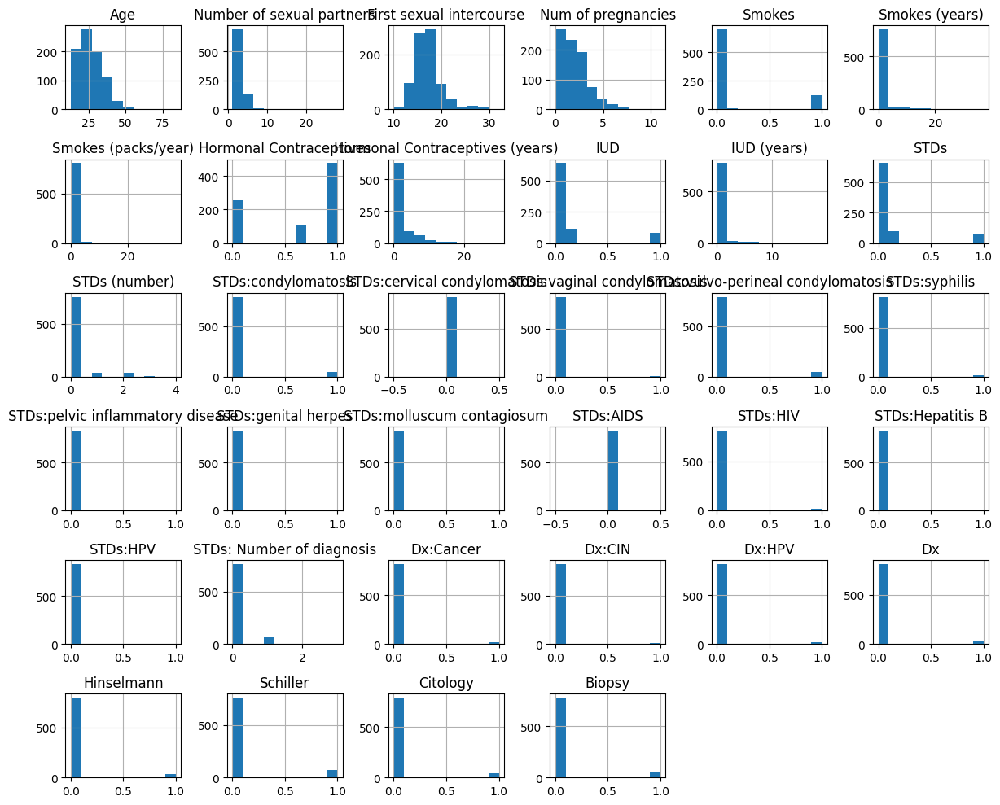

In [23]:


df.hist(figsize=(12,10))
plt.tight_layout()
plt.show()

Explore Relationships with Scatter Plots

Explore pairwise relationships between numerical variables using scatter plots. This helps in identifying potential correlations or patterns.

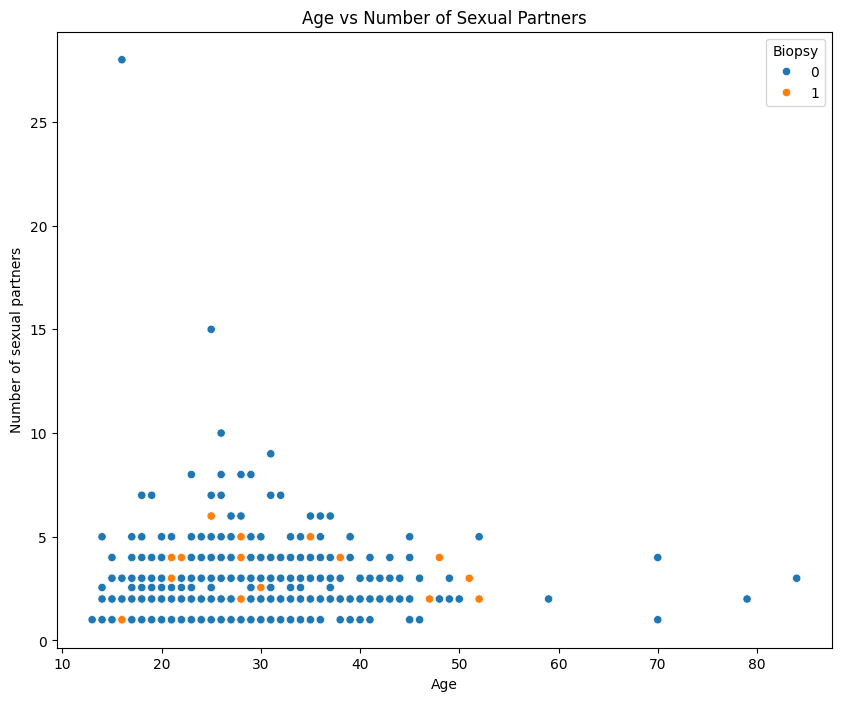

In [ ]:
# Example: Scatter plot
plt.figure(figsize=(10, 8))
sns.scatterplot(x='Age', y='Number of sexual partners', data=df, hue='Biopsy')
plt.title('Age vs Number of Sexual Partners')
plt.show()


Plot scatter plots of each feature against the target variable to visually inspect relationships.

Linear Relationship: Points form a line or a pattern that resembles a straight line.

Non-Linear Relationship: Points form a curve or more complex pattern.

Correlation coefficients range from -1 to 1, where:

1 indicates a perfect positive correlation (as one variable increases, the other increases).

-1 indicates a perfect negative correlation (as one variable increases, the other decreases).

0 indicates no correlation (the variables are independent of each other).

Color Coding:

Red Cells: Indicate a strong positive correlation (close to 1).

 For example, if one feature increases, the other also tends to increase.

Blue Cells: Indicate a strong negative correlation (close to -1).

 For example, if one feature increases, the other tends to decrease.
 
White Cells: Indicate no correlation (close to 0).
Annotated Values:

Each cell will have a number indicating the exact correlation coefficient between the respective pair of features.
Diagonal Line:

The diagonal line from the top-left to the bottom-right of the heatmap will always show a correlation of 1,
 as each feature is perfectly correlated with itself.

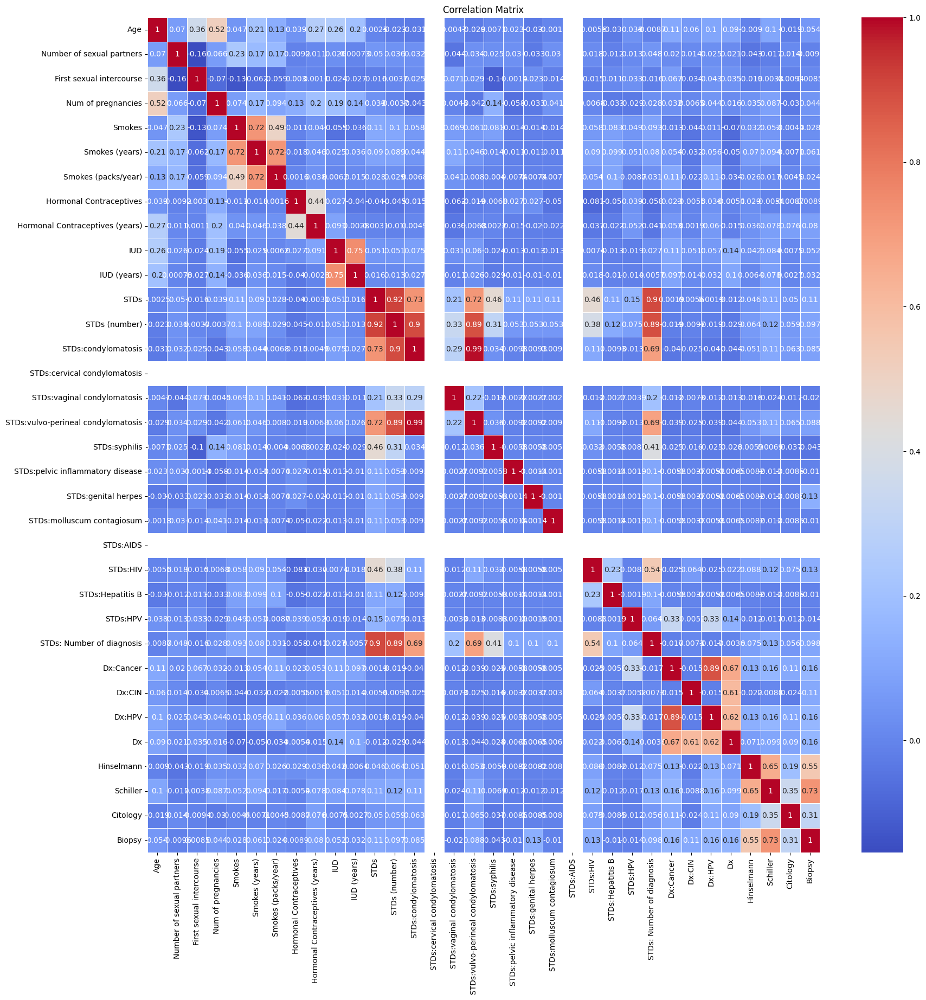

In [ ]:
# Calculate correlations
correlation_matrix = df.corr()

# Plot heatmap of correlations
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.title('Correlation Matrix')
plt.show()


Access feature importance with RandomForest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Assuming the target variable is 'target_column'
target = 'Biopsy'

# Encoding categorical variables
df_encoded = df.copy()
for column in df.columns:
    if df[column].dtype == 'object':
        le = LabelEncoder()
        df_encoded[column] = le.fit_transform(df[column])

# Splitting data
X = df_encoded.drop(target, axis=1)
y = df_encoded[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Fit a RandomForest model
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Feature importance
importances = model.feature_importances_
feature_importance_df = pd.DataFrame({'feature': X.columns, 'importance': importances})
feature_importance_df = feature_importance_df.sort_values(by='importance', ascending=False)

print(feature_importance_df)


                               feature  importance
31                            Schiller    0.275090
30                          Hinselmann    0.103611
0                                  Age    0.087715
2             First sexual intercourse    0.070598
8      Hormonal Contraceptives (years)    0.070330
3                   Num of pregnancies    0.067250
32                            Citology    0.056276
1            Number of sexual partners    0.043974
6                  Smokes (packs/year)    0.023726
10                         IUD (years)    0.022977
5                       Smokes (years)    0.021073
19                 STDs:genital herpes    0.016991
27                              Dx:CIN    0.015961
9                                  IUD    0.015380
29                                  Dx    0.014274
7              Hormonal Contraceptives    0.013837
12                       STDs (number)    0.012647
11                                STDs    0.011905
4                              

Check for Non-Linear Relationships

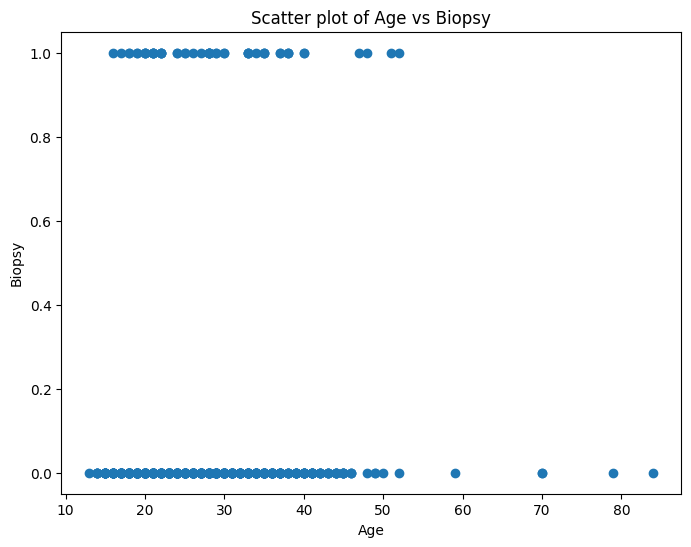

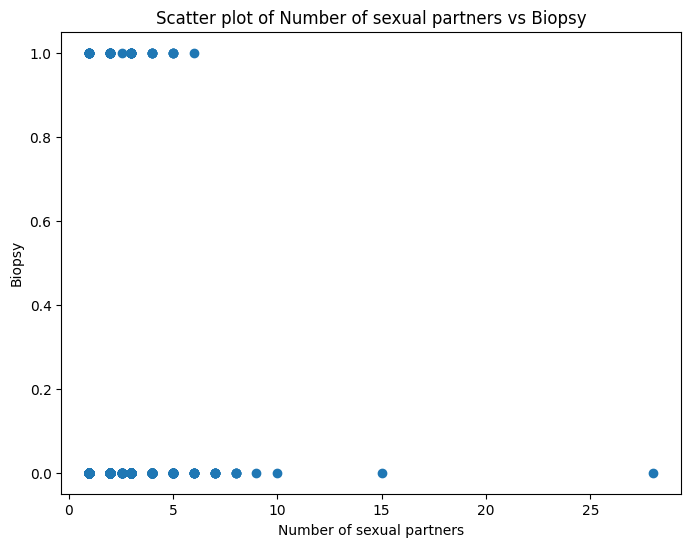

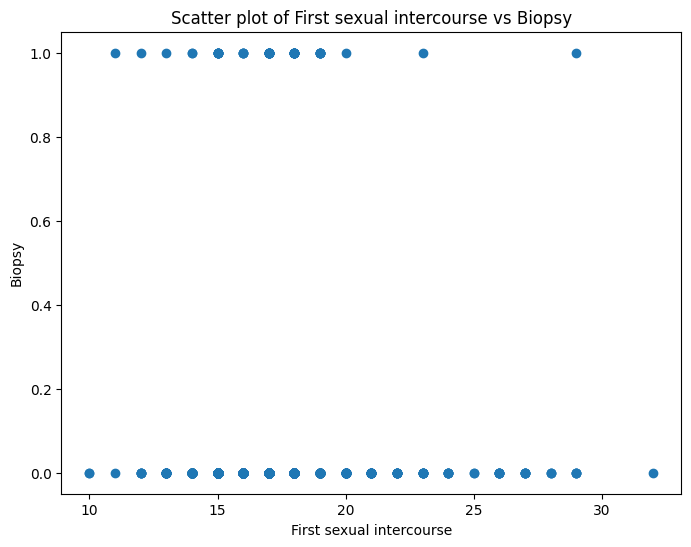

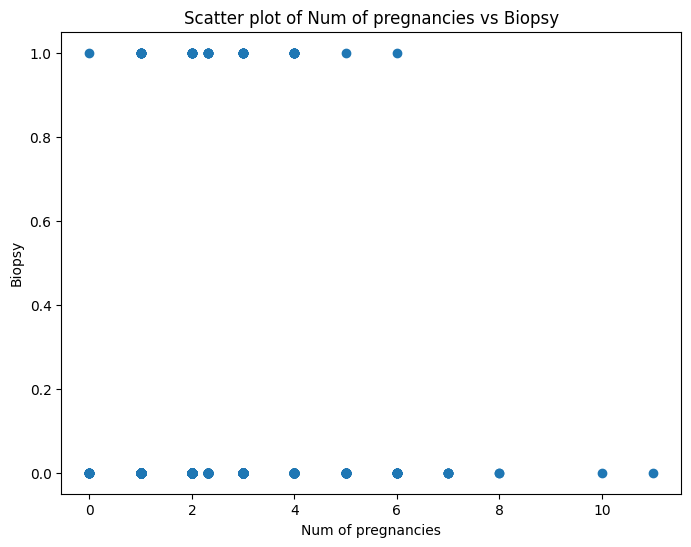

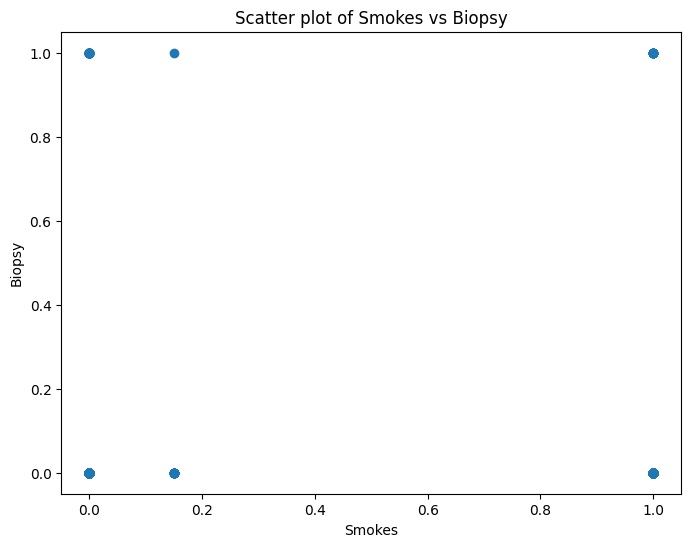

...

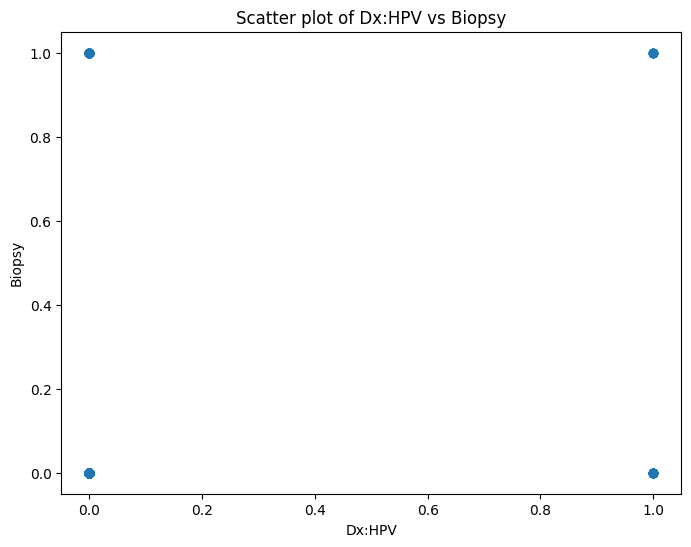

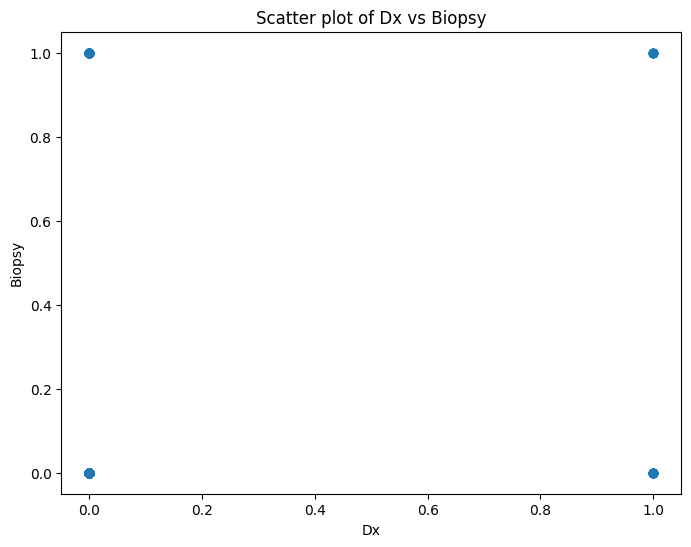

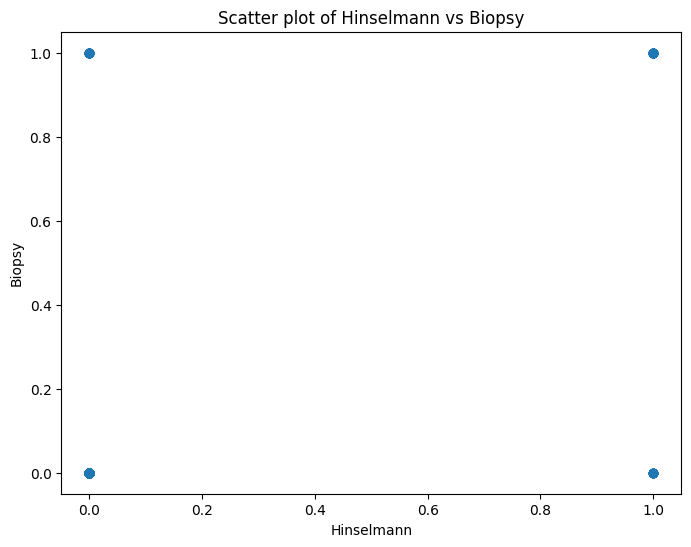

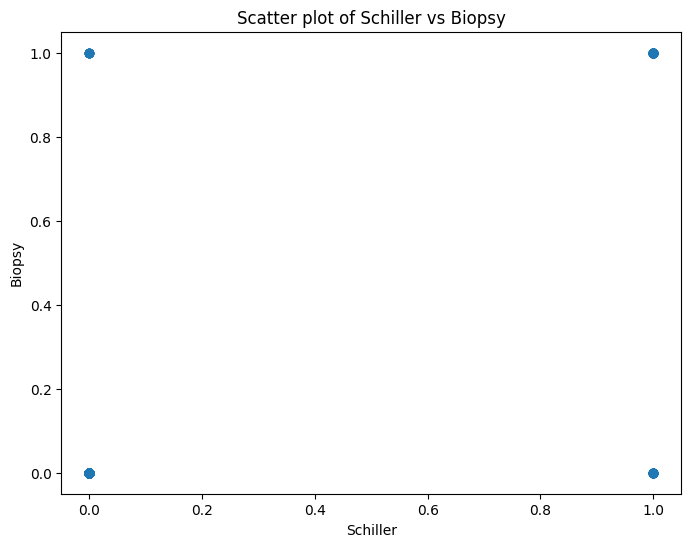

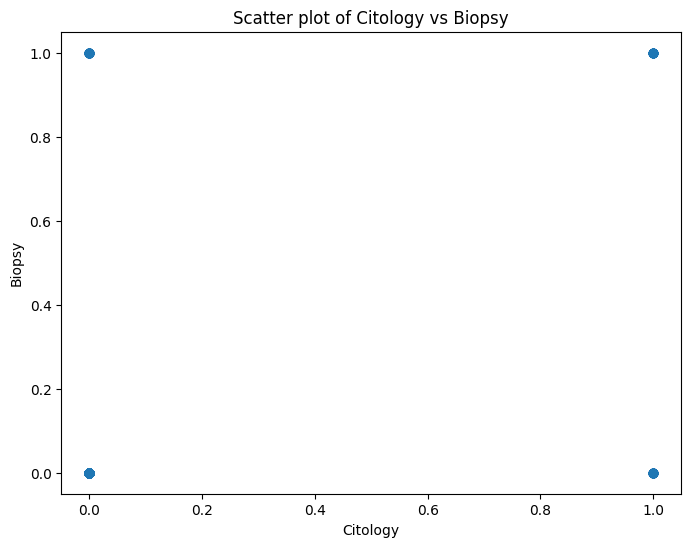

In [ ]:
# Plot scatter plots to check for non-linear relationships
for column in df.columns:
    if column != target:
        plt.figure(figsize=(8, 6))
        plt.scatter(df[column], df[target])
        plt.title(f'Scatter plot of {column} vs {target}')
        plt.xlabel(column)
        plt.ylabel(target)
        plt.show()


Check for Multicollinearity
Use the Variance Inflation Factor (VIF) to check for multicollinearity.

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(len(X.columns))]

print(vif_data)


d:\Projects\Python\ML\cervical\venv\lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)
d:\Projects\Python\ML\cervical\venv\lib\site-packages\statsmodels\regression\linear_model.py:1785: RuntimeWarning: invalid value encountered in scalar divide
  return 1 - self.ssr/self.uncentered_tss


                               feature        VIF
0                                  Age  24.142355
1            Number of sexual partners   3.421834
2             First sexual intercourse  18.267834
3                   Num of pregnancies   5.679013
4                               Smokes   2.672322
5                       Smokes (years)   4.072170
6                  Smokes (packs/year)   2.414554
7              Hormonal Contraceptives   4.011943
8      Hormonal Contraceptives (years)   2.031555
9                                  IUD   2.860063
10                         IUD (years)   2.548337
11                                STDs  14.752284
12                       STDs (number)        inf
13                 STDs:condylomatosis        inf
14        STDs:cervical condylomatosis        NaN
15         STDs:vaginal condylomatosis        inf
16  STDs:vulvo-perineal condylomatosis        inf
17                       STDs:syphilis        inf
18    STDs:pelvic inflammatory disease        inf


 Dimensionality Reduction (PCA)
You can apply PCA to reduce dimensions while keeping most of the information

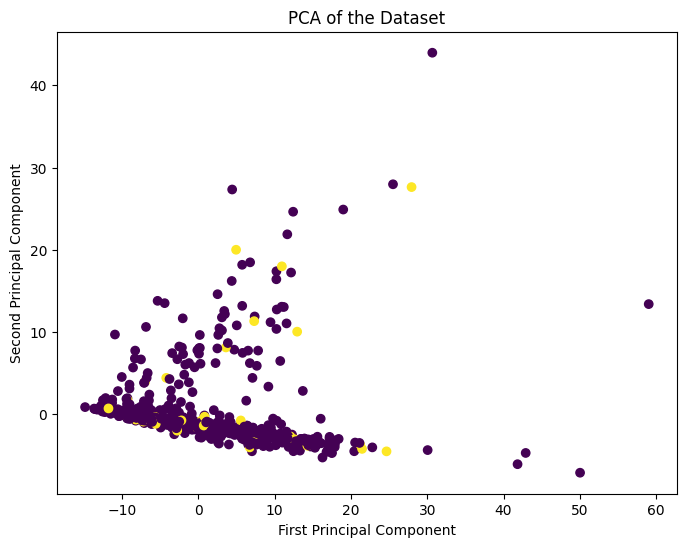

In [ ]:
from sklearn.decomposition import PCA

# Apply PCA
pca = PCA(n_components=2)  # Choose the number of components
X_pca = pca.fit_transform(X)

# Plotting the PCA components
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y)
plt.title('PCA of the Dataset')
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')
plt.show()


Evaluate Impact on Model Performance
Evaluate model performance with and without the columns in question.

In [ ]:
# Removing low importance columns and re-training the model
low_importance_columns = feature_importance_df[feature_importance_df['importance'] < 0.01]['feature']
X_reduced = X.drop(low_importance_columns, axis=1)

X_train_reduced, X_test_reduced, y_train, y_test = train_test_split(X_reduced, y, test_size=0.3, random_state=42)
model_reduced = RandomForestClassifier(random_state=42)
model_reduced.fit(X_train_reduced, y_train)

# Evaluate the performance

y_pred_original = model.predict(X_test)
y_pred_reduced = model_reduced.predict(X_test_reduced)

original_accuracy = accuracy_score(y_test, y_pred_original)
reduced_accuracy = accuracy_score(y_test, y_pred_reduced)

print(f'Original Model Accuracy: {original_accuracy}')
print(f'Reduced Model Accuracy: {reduced_accuracy}')


Original Model Accuracy: 0.9601593625498008
Reduced Model Accuracy: 0.9601593625498008


In [ ]:
columns=X.columns
print(f"columns: {columns}")

columns: Index(['Age', 'Number of sexual partners', 'First sexual intercourse',
       'Num of pregnancies', 'Smokes', 'Smokes (years)', 'Smokes (packs/year)',
       'Hormonal Contraceptives', 'Hormonal Contraceptives (years)', 'IUD',
       'IUD (years)', 'STDs', 'STDs (number)', 'STDs:condylomatosis',
       'STDs:cervical condylomatosis', 'STDs:vaginal condylomatosis',
       'STDs:vulvo-perineal condylomatosis', 'STDs:syphilis',
       'STDs:pelvic inflammatory disease', 'STDs:genital herpes',
       'STDs:molluscum contagiosum', 'STDs:AIDS', 'STDs:HIV',
       'STDs:Hepatitis B', 'STDs:HPV', 'STDs: Number of diagnosis',
       'Dx:Cancer', 'Dx:CIN', 'Dx:HPV', 'Dx', 'Hinselmann', 'Schiller',
       'Citology'],
      dtype='object')


Normalize data

In [ ]:
scaler = StandardScaler()
X_normalized_df = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

# Concatenate the normalized features with the target variable
df = pd.concat([X_normalized_df, y.reset_index(drop=True)], axis=1)

# Save the scaler parameters
scaler_params = {
    'mean': scaler.mean_.tolist(),
    'scale': scaler.scale_.tolist()
}

X = df.drop('Biopsy', axis=1,inplace=False)
y = df['Biopsy']

Feature Selection

Feature selection is crucial for building effective predictive models.

 It involves selecting the most relevant features that contribute the most to predicting the target variable (cervical cancer diagnosis in this case). 
 
 Techniques include:

Correlation Analysis: Identify features that are highly correlated with the target variable or with each other.

Chi-Square Test: Assess the independence between categorical variables and the target variable.

Mutual Information: Measure the amount of information obtained about one variable through another variable

In [39]:
from sklearn.model_selection import train_test_split

X = df.drop('Biopsy', axis=1)
y = df['Biopsy']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

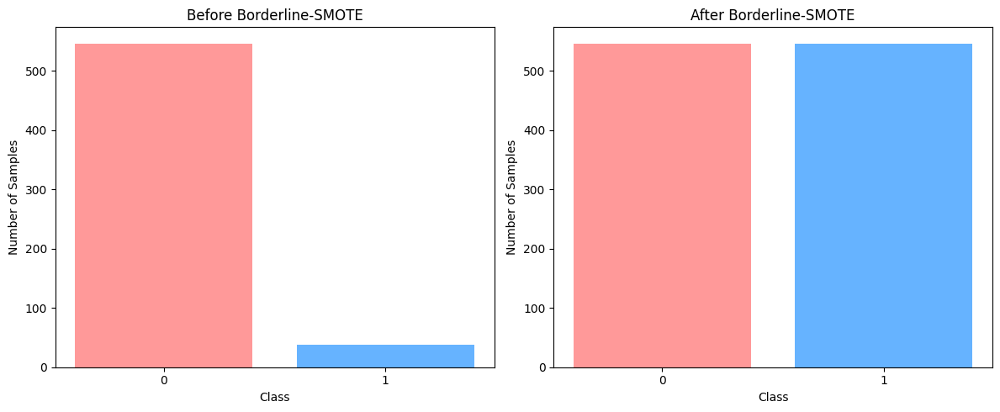

In [42]:
from collections import Counter
from imblearn.over_sampling import BorderlineSMOTE

# Assuming 'X' is your feature matrix and 'y' is the target vector
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Visualize the target distribution before resampling
counter_before = Counter(y_train)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.bar(counter_before.keys(), counter_before.values(), color=['#ff9999','#66b3ff'])
plt.title('Before Borderline-SMOTE')
plt.xlabel('Class')
plt.ylabel('Number of Samples')
plt.xticks([0, 1])

# Apply Borderline-SMOTE
borderline_smote = BorderlineSMOTE(random_state=42)
X_resampled, y_resampled = borderline_smote.fit_resample(X_train, y_train)

# Visualize the target distribution after resampling
counter_after = Counter(y_resampled)
plt.subplot(1, 2, 2)
plt.bar(counter_after.keys(), counter_after.values(), color=['#ff9999','#66b3ff'])
plt.title('After Borderline-SMOTE')
plt.xlabel('Class')
plt.ylabel('Number of Samples')
plt.xticks([0, 1])

plt.tight_layout()
plt.show()

 Algorithm Selection and Training

1. Start with Basic Algorithms

a. Logistic Regression:

Algorithm Overview: 
Logistic Regression is a linear model that predicts the probability of a binary outcome (e.g., presence or absence of cervical cancer) based on input features.

Advantages: Simple and interpretable, works well when the relationship between features and target is linear

In [43]:
from sklearn.linear_model import LogisticRegression

# Initialize Logistic Regression model
model_lr = LogisticRegression()

# Train the model
model_lr.fit(X_resampled, y_resampled)

# print(df.isnull().sum())


d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [44]:

# Evaluate Logistic Regression model
y_pred_lr = model_lr.predict(X_test)

accuracy_lr = accuracy_score(y_test, y_pred_lr)
precision_lr = precision_score(y_test, y_pred_lr)
recall_lr = recall_score(y_test, y_pred_lr)
f1_lr = f1_score(y_test, y_pred_lr)
roc_auc_lr = roc_auc_score(y_test, model_lr.predict_proba(X_test)[:, 1])

print(f"Logistic Regression Metrics:")
print(f"Accuracy: {accuracy_lr:.2f}")
print(f"Precision: {precision_lr:.2f}")
print(f"Recall: {recall_lr:.2f}")
print(f"F1 Score: {f1_lr:.2f}")
print(f"ROC-AUC Score: {roc_auc_lr:.2f}")





Logistic Regression Metrics:
Accuracy: 0.96
Precision: 0.64
Recall: 0.88
F1 Score: 0.74
ROC-AUC Score: 0.96


Decision Trees:

Algorithm Overview: Decision Trees split the data into subsets based on the most significant attributes,

 aiming to create homogeneous subsets that predict the target variable.

Advantages: Non-linear, can capture complex interactions between features.

In [45]:
from sklearn.tree import DecisionTreeClassifier

# Initialize Decision Tree model
model_dt = DecisionTreeClassifier()

# Train the model
model_dt.fit(X_resampled, y_resampled)


DecisionTreeClassifier()

In [46]:


# Predictions
y_pred_dt = model_dt.predict(X_test)

# Evaluation Metrics
accuracy_dt = accuracy_score(y_test, y_pred_dt)
precision_dt = precision_score(y_test, y_pred_dt)
recall_dt = recall_score(y_test, y_pred_dt)
f1_dt = f1_score(y_test, y_pred_dt)
roc_auc_dt = roc_auc_score(y_test, model_dt.predict_proba(X_test)[:, 1])

# Print Metrics
print("Decision Tree Classifier Metrics:")
print(f"Accuracy: {accuracy_dt:.2f}")
print(f"Precision: {precision_dt:.2f}")
print(f"Recall: {recall_dt:.2f}")
print(f"F1 Score: {f1_dt:.2f}")
print(f"ROC-AUC Score: {roc_auc_dt:.2f}")

Decision Tree Classifier Metrics:
Accuracy: 0.96
Precision: 0.75
Recall: 0.56
F1 Score: 0.64
ROC-AUC Score: 0.77


 K-Nearest Neighbors (KNN):

Algorithm Overview: KNN predicts the class of a data point based on the classes of its nearest neighbors in feature space.

Advantages: Instance-based learning, no training phase, can capture local patterns.

In [47]:
from sklearn.neighbors import KNeighborsClassifier

# Initialize KNN model
model_knn = KNeighborsClassifier()

# Train the model
model_knn.fit(X_resampled, y_resampled)


KNeighborsClassifier()

In [48]:

# Predictions
y_pred_knn = model_knn.predict(X_test)

# Evaluation Metrics
accuracy_knn = accuracy_score(y_test, y_pred_knn)
precision_knn = precision_score(y_test, y_pred_knn)
recall_knn = recall_score(y_test, y_pred_knn)
f1_knn = f1_score(y_test, y_pred_knn)
roc_auc_knn = roc_auc_score(y_test, model_knn.predict_proba(X_test)[:, 1])

# Print Metrics
print("K-Nearest Neighbors Classifier Metrics:")
print(f"Accuracy: {accuracy_knn:.2f}")
print(f"Precision: {precision_knn:.2f}")
print(f"Recall: {recall_knn:.2f}")
print(f"F1 Score: {f1_knn:.2f}")
print(f"ROC-AUC Score: {roc_auc_knn:.2f}")

K-Nearest Neighbors Classifier Metrics:
Accuracy: 0.86
Precision: 0.22
Recall: 0.44
F1 Score: 0.29
ROC-AUC Score: 0.71


3. Experiment with Advanced Algorithms

Random Forest:

Algorithm Overview: Random Forest is an ensemble learning method that constructs 

multiple decision trees during training and outputs the class that is the mode of the classes of the individual trees.

Advantages: Reduces overfitting, robust to outliers and noise, handles large datasets.

In [49]:
from sklearn.ensemble import RandomForestClassifier

# Initialize Random Forest model
model_rf = RandomForestClassifier()

# Train the model
model_rf.fit(X_resampled, y_resampled)


RandomForestClassifier()

In [50]:
print(X_test.shape)
y_pred_rf = model_rf.predict(X_test)

# Probability estimates for ROC-AUC
y_proba_rf = model_rf.predict_proba(X_test)[:, 1]

# Evaluation Metrics
accuracy_rf = accuracy_score(y_test, y_pred_rf)
precision_rf = precision_score(y_test, y_pred_rf)
recall_rf = recall_score(y_test, y_pred_rf)
f1_rf = f1_score(y_test, y_pred_rf)
roc_auc_rf = roc_auc_score(y_test, y_proba_rf)

# Print Metrics
print("Random Forest Classifier Metrics:")
print(f"Predictions: {y_pred_rf}")
print(f"Accuracy: {accuracy_rf:.2f}")
print(f"Precision: {precision_rf:.2f}")
print(f"Recall: {recall_rf:.2f}")
print(f"F1 Score: {f1_rf:.2f}")
print(f"ROC-AUC Score: {roc_auc_rf:.2f}")

(251, 33)
Random Forest Classifier Metrics:
Predictions: [0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Accuracy: 0.96
Precision: 0.75
Recall: 0.56
F1 Score: 0.64
ROC-AUC Score: 0.99


Support Vector Machines (SVM):

Algorithm Overview: SVM finds a hyperplane in an N-dimensional space that distinctly classifies data points into different classes.

Advantages: Effective in high-dimensional spaces, versatile with different kernel functions, 

and effective in cases where the number of dimensions is greater than the number of samples.

In [51]:
from sklearn.svm import SVC

# Initialize SVM model
model_svm =  SVC(probability=True)

# Train the model
model_svm.fit(X_resampled, y_resampled)


SVC(probability=True)

In [52]:
y_pred_svm = model_svm.predict(X_test)

# Evaluation Metrics
accuracy_svm = accuracy_score(y_test, y_pred_svm)
precision_svm = precision_score(y_test, y_pred_svm)
recall_svm = recall_score(y_test, y_pred_svm)
f1_svm = f1_score(y_test, y_pred_svm)
roc_auc_svm = roc_auc_score(y_test, model_svm.predict_proba(X_test)[:, 1])

# Print Metrics
print("SVM Classifier Metrics:")
print(f"Accuracy: {accuracy_svm:.2f}")
print(f"Precision: {precision_svm:.2f}")
print(f"Recall: {recall_svm:.2f}")
print(f"F1 Score: {f1_svm:.2f}")
print(f"ROC-AUC Score: {roc_auc_svm:.2f}")

SVM Classifier Metrics:
Accuracy: 0.91
Precision: 0.39
Recall: 0.69
F1 Score: 0.50
ROC-AUC Score: 0.85


Gradient Boosting (e.g., XGBoost, LightGBM):

Algorithm Overview: Gradient Boosting builds trees sequentially, where each new tree helps to correct errors made by the previously trained set of trees.

Advantages: Often provides higher accuracy than individual models, handles missing data, and supports regularization

In [53]:
from sklearn.ensemble import GradientBoostingClassifier
# Model Training
model_gbc = GradientBoostingClassifier()
model_gbc.fit(X_resampled, y_resampled)

GradientBoostingClassifier()

In [54]:


# Predictions
y_pred_gbc = model_gbc.predict(X_test)

# Evaluation Metrics
accuracy_gbc = accuracy_score(y_test, y_pred_gbc)
precision_gbc = precision_score(y_test, y_pred_gbc)
recall_gbc = recall_score(y_test, y_pred_gbc)
f1_gbc = f1_score(y_test, y_pred_gbc)
roc_auc_gbc = roc_auc_score(y_test, model_gbc.predict_proba(X_test)[:, 1])

# Print Metrics
print("Gradient Boosting Classifier Metrics:")
print(f"Accuracy: {accuracy_gbc:.2f}")
print(f"Precision: {precision_gbc:.2f}")
print(f"Recall: {recall_gbc:.2f}")
print(f"F1 Score: {f1_gbc:.2f}")
print(f"ROC-AUC Score: {roc_auc_gbc:.2f}")

Gradient Boosting Classifier Metrics:
Accuracy: 0.96
Precision: 0.68
Recall: 0.81
F1 Score: 0.74
ROC-AUC Score: 0.96


TensorFlow

In [55]:
model = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation='relu', input_shape=(X_resampled.shape[1],)),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

d:\Projects\Python\ML\cervical\venv\lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [56]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [57]:
model.fit(X_resampled, y_resampled, epochs=10, batch_size=32, validation_split=0.2)

Epoch 1/10
28/28 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - accuracy: 0.5682 - loss: 1.1071 - val_accuracy: 0.4018 - val_loss: 0.7277
Epoch 2/10
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7029 - loss: 0.5612 - val_accuracy: 0.6530 - val_loss: 0.5720
Epoch 3/10
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7767 - loss: 0.4910 - val_accuracy: 0.5251 - val_loss: 0.7073
Epoch 4/10
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8048 - loss: 0.4272 - val_accuracy: 0.7945 - val_loss: 0.4637
Epoch 5/10
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8807 - loss: 0.3646 - val_accuracy: 0.7763 - val_loss: 0.4799
Epoch 6/10
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9138 - loss: 0.2967 - val_accuracy: 0.8174 - val_loss: 0.4389
Epoch 7/10
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9119 - loss: 0.2607 - val_accuracy: 0.9498 - val_loss: 0.2233
Epoch 8/10
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9479 - loss: 0.2199 - val_accuracy: 0.9361 - val_loss

In [58]:
y_pred_proba = model.predict(X_test)  #
y_pred = (y_pred_proba > 0.5).astype(int)
# Flatten y_test and y_pred for sklearn metrics
y_test_flat = y_test.values.flatten()  # Flatten to ensure it's a 1D array
y_pred_flat = y_pred.flatten()         # Flatten to ensure it's a 1D array

# Calculate metrics
accuracy = accuracy_score(y_test_flat, y_pred_flat)
precision = precision_score(y_test_flat, y_pred_flat)
recall = recall_score(y_test_flat, y_pred_flat)
f1 = f1_score(y_test_flat, y_pred_flat)
roc_auc = roc_auc_score(y_test_flat, y_pred_proba)  # ROC-AUC score uses probabilities

# Print metrics
# print(f"Predictions: {y_pred_proba}, prob {y_pred}, flat {y_pred_flat}")
print(f"Accuracy: {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")
print(f"ROC-AUC Score: {roc_auc:.2f}")


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
Accuracy: 0.94
Precision: 0.52
Recall: 0.75
F1 Score: 0.62
ROC-AUC Score: 0.96


In [62]:
from sklearn.metrics import confusion_matrix,classification_report
y_preds=model.predict(X)
y_preds=np.round(y_preds)
print("report \n",classification_report(y,y_preds))

27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
report 
               precision    recall  f1-score   support

           0       0.98      0.96      0.97       781
           1       0.59      0.78      0.67        54

    accuracy                           0.95       835
   macro avg       0.79      0.87      0.82       835
weighted avg       0.96      0.95      0.95       835



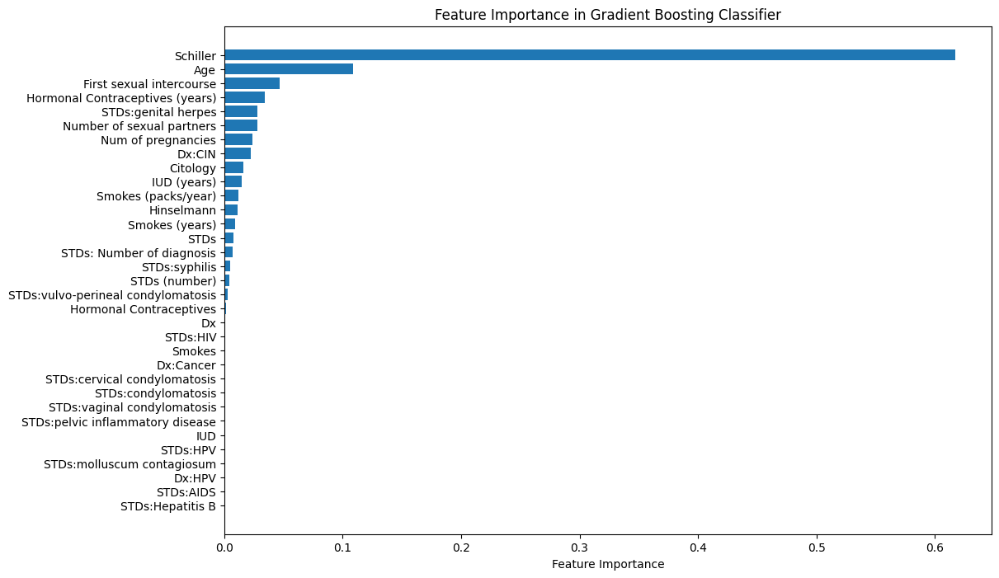

In [ ]:
feature_importance = model_gbc.feature_importances_
sorted_idx = np.argsort(feature_importance)
plt.figure(figsize=(12, 8))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), X.columns[sorted_idx])
plt.xlabel("Feature Importance")
plt.title("Feature Importance in Gradient Boosting Classifier")
plt.show()

In [38]:
X = df.drop(columns=['Biopsy'])
y = df['Biopsy']

# Define train-test split ratios


In [ ]:
splits = [(0.7, 0.3), (0.8, 0.2)]

In [ ]:
# Define models
models = {
    'KNeighbors': KNeighborsClassifier(),
    'DecisionTree': DecisionTreeClassifier(),
    'RandomForest': RandomForestClassifier(),
    'SVM': SVC(probability=True),
    'XGBoost': GradientBoostingClassifier()
}

# Define TensorFlow model
def create_tf_model():
    model = Sequential()
    model.add(Dense(64, activation='relu', input_shape=(X.shape[1],)))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

models['TensorFlow'] = create_tf_model()


d:\Projects\Python\ML\cervical\venv\lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
results = []

def evaluate_keras_model(X_train, y_train, X_test, y_test):
    model = create_tf_model()
    model.fit(X_train, y_train, epochs=10, batch_size=32, verbose=0)
    y_pred_proba = model.predict(X_test)
    y_pred = (y_pred_proba > 0.5).astype(int).flatten()
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    return accuracy, precision, recall

for model_name, model in models.items():
    for train_ratio, test_ratio in splits:
        X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=train_ratio, test_size=test_ratio, random_state=42)
        
        if model_name == 'TensorFlow':
            accuracy, precision, recall = evaluate_keras_model(X_train, y_train, X_test, y_test)
        else:
            model.fit(X_train, y_train)
            y_pred = model.predict(X_test)
            accuracy = accuracy_score(y_test, y_pred)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
        
        results.append({
            'Model': model_name,
            'Train Ratio': train_ratio,
            'Test Ratio': test_ratio,
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall
        })

# Convert results to DataFrame
results_df = pd.DataFrame(results)
print(results_df)


d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\Projects\Python\ML\cervical\

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\Projects\Python\ML\cervical\venv\lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
           Model  Train Ratio  Test Ratio  Accuracy  Precision  Recall
0     KNeighbors          0.7         0.3  0.936255   0.000000  0.0000
1     KNeighbors          0.8         0.2  0.940120   0.000000  0.0000
2   DecisionTree          0.7         0.3  0.952191   0.700000  0.4375
3   DecisionTree          0.8         0.2  0.970060   0.727273  0.8000
4   RandomForest          0.7         0.3  0.956175   0.727273  0.5000
5   RandomForest          0.8         0.2  0.970060   0.857143  0.6000
6            SVM          0.7         0.3  0.936255   0.000000  0.0000
7            SVM          0.8         0.2  0.940120   0.000000  0.0000
8        XGBoost          0.7         0.3  0.956175   0.692308  0.5625
9        XGBoost          0.8         0.2  0.970060   0.777778  0.7000
10    TensorFlow          0.7         0.3  0.936255   0.000000  0.0000
11    TensorFlow          0.8         0.2  0.940120   0.500000  0.1000


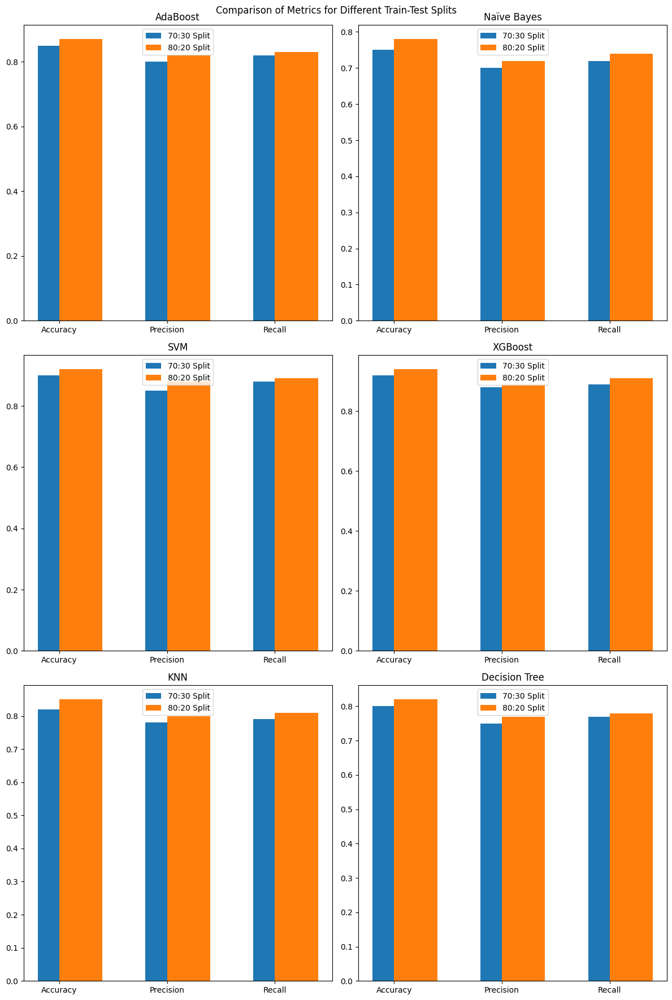

In [ ]:
import matplotlib.pyplot as plt

# Sample data for each algorithm and metric
metrics = ['Accuracy', 'Precision', 'Recall']
models = ['AdaBoost', 'Naïve Bayes', 'SVM', 'XGBoost', 'KNN', 'Decision Tree']

# These should be replaced with actual metric values from the models
results_7030 = {
    'AdaBoost': [0.85, 0.80, 0.82],
    'Naïve Bayes': [0.75, 0.70, 0.72],
    'SVM': [0.90, 0.85, 0.88],
    'XGBoost': [0.92, 0.88, 0.89],
    'KNN': [0.82, 0.78, 0.79],
    'Decision Tree': [0.80, 0.75, 0.77]
}

results_8020 = {
    'AdaBoost': [0.87, 0.82, 0.83],
    'Naïve Bayes': [0.78, 0.72, 0.74],
    'SVM': [0.92, 0.88, 0.89],
    'XGBoost': [0.94, 0.89, 0.91],
    'KNN': [0.85, 0.80, 0.81],
    'Decision Tree': [0.82, 0.77, 0.78]
}

# Plotting
fig, axes = plt.subplots(3, 2, figsize=(12, 18))
fig.suptitle('Comparison of Metrics for Different Train-Test Splits')

for idx, model in enumerate(models):
    row, col = divmod(idx, 2)
    ax = axes[row, col]
    for item in 
    ax.bar(metrics, results_7030[model], width=0.4, label='70:30 Split', align='center')
    ax.bar(metrics, results_8020[model], width=0.4, label='80:20 Split', align='edge')
    ax.set_title(model)
    ax.legend()

plt.tight_layout()
plt.show()


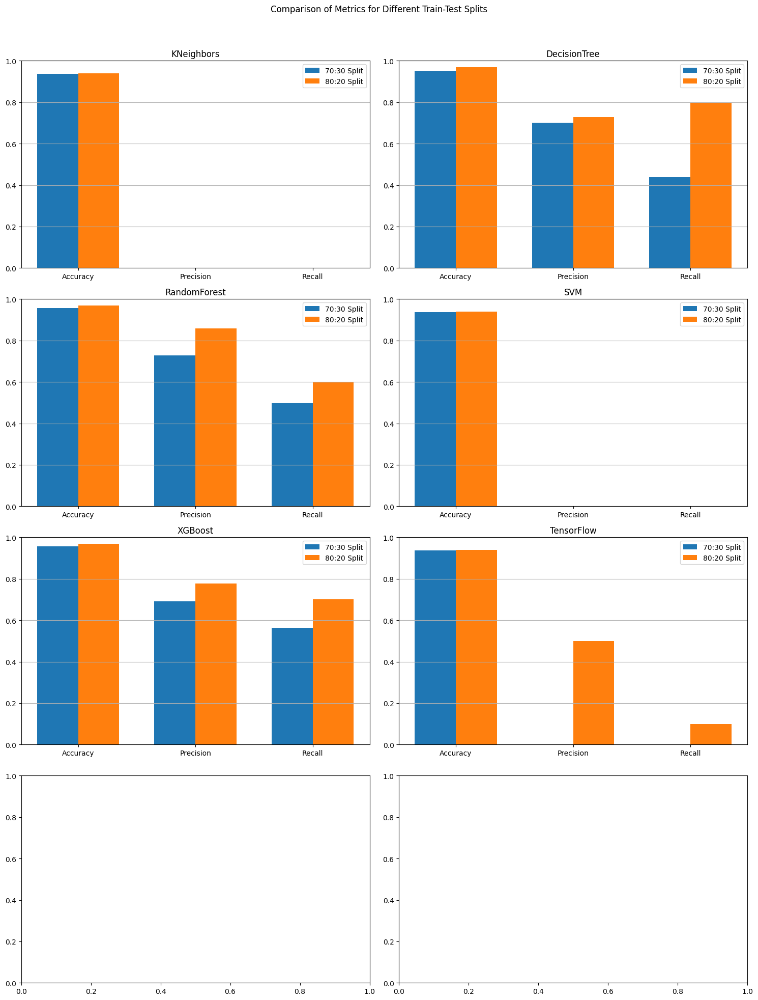

In [ ]:
# Extracting unique models from results_df
unique_models = results_df['Model'].unique()

# Metrics to be plotted
metrics = ['Accuracy', 'Precision', 'Recall']

# Data structure for storing the metrics
results_data = {model: {'70:30': {}, '80:20': {}} for model in unique_models}

# Filling the data structure with the metric values from results_df
for index, row in results_df.iterrows():
    model = row['Model']
    train_test_split = f"{int(row['Train Ratio']*100)}:{int(row['Test Ratio']*100)}"
    results_data[model][train_test_split]['Accuracy'] = row['Accuracy']
    results_data[model][train_test_split]['Precision'] = row['Precision']
    results_data[model][train_test_split]['Recall'] = row['Recall']

# Plotting the comparison graphs
fig, axes = plt.subplots(4, 2, figsize=(15, 20))  # Adjusted the number of subplots
fig.suptitle('Comparison of Metrics for Different Train-Test Splits')

# Flatten the axes for easier iteration if there's an odd number of subplots
axes = axes.flatten()

for idx, model in enumerate(unique_models):
    ax = axes[idx]
    width = 0.35  # Width of the bars
    x = range(len(metrics))  # X-axis positions

    # Extracting the values for each split
    values_7030 = [results_data[model]['70:30'][metric] for metric in metrics]
    values_8020 = [results_data[model]['80:20'][metric] for metric in metrics]

    # Plotting bars for each metric and train-test split
    ax.bar([p - width/2 for p in x], values_7030, width=width, label='70:30 Split')
    ax.bar([p + width/2 for p in x], values_8020, width=width, label='80:20 Split')
    
    ax.set_title(model)
    ax.set_xticks(x)
    ax.set_xticklabels(metrics)
    ax.set_ylim(0, 1)
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [ ]:
metrics = {
    'KNeighbors': {'accuracy': 0, 'precision': 0, 'recall': 0},
    'DecisionTree': {'accuracy': 0, 'precision': 0, 'recall': 0},
    'RandomForest': {'accuracy': 0, 'precision': 0, 'recall': 0},
    'SVM': {'accuracy': 0, 'precision': 0, 'recall': 0},
    'XGBoost': {'accuracy': 0, 'precision': 0, 'recall': 0},
    'LogisticRegression': {'accuracy': 0, 'precision': 0, 'recall': 0},
    'TensorFlow': {'accuracy': 0, 'precision': 0, 'recall': 0},
}

# KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(X_train, y_train)
knn_preds = knn.predict(X_test)
metrics['KNeighbors']['accuracy'] = accuracy_score(y_test, knn_preds)
metrics['KNeighbors']['precision'] = precision_score(y_test, knn_preds)
metrics['KNeighbors']['recall'] = recall_score(y_test, knn_preds)

# DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
dt_preds = dt.predict(X_test)
metrics['DecisionTree']['accuracy'] = accuracy_score(y_test, dt_preds)
metrics['DecisionTree']['precision'] = precision_score(y_test, dt_preds)
metrics['DecisionTree']['recall'] = recall_score(y_test, dt_preds)

# RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
rf_preds = rf.predict(X_test)
metrics['RandomForest']['accuracy'] = accuracy_score(y_test, rf_preds)
metrics['RandomForest']['precision'] = precision_score(y_test, rf_preds)
metrics['RandomForest']['recall'] = recall_score(y_test, rf_preds)

# SVM
svm = SVC()
svm.fit(X_train, y_train)
svm_preds = svm.predict(X_test)
metrics['SVM']['accuracy'] = accuracy_score(y_test, svm_preds)
metrics['SVM']['precision'] = precision_score(y_test, svm_preds)
metrics['SVM']['recall'] = recall_score(y_test, svm_preds)

# XGBoost
xgb = GradientBoostingClassifier()
xgb.fit(X_train, y_train)
xgb_preds = xgb.predict(X_test)
metrics['XGBoost']['accuracy'] = accuracy_score(y_test, xgb_preds)
metrics['XGBoost']['precision'] = precision_score(y_test, xgb_preds)
metrics['XGBoost']['recall'] = recall_score(y_test, xgb_preds)

# Logistic Regression (Linear Regression is not suitable for classification)
lr = LogisticRegression()
lr.fit(X_train, y_train)
lr_preds = lr.predict(X_test)
metrics['LogisticRegression']['accuracy'] = accuracy_score(y_test, lr_preds)
metrics['LogisticRegression']['precision'] = precision_score(y_test, lr_preds)
metrics['LogisticRegression']['recall'] = recall_score(y_test, lr_preds)

# TensorFlow
def create_model():
    model = Sequential([
        Dense(64, activation='relu', input_shape=(X_train.shape[1],)),
        Dense(32, activation='relu'),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

model = create_model()
model.fit(X_train, y_train, epochs=10, verbose=0)
tf_preds = (model.predict(X_test) > 0.5).astype(int)
metrics['TensorFlow']['accuracy'] = accuracy_score(y_test, tf_preds)
metrics['TensorFlow']['precision'] = precision_score(y_test, tf_preds)
metrics['TensorFlow']['recall'] = recall_score(y_test, tf_preds)

# Print metrics
for algo, scores in metrics.items():
    print(f"{algo}:")
    print(f"  Accuracy: {scores['accuracy']:.4f}")
    print(f"  Precision: {scores['precision']:.4f}")
    print(f"  Recall: {scores['recall']:.4f}")

d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer t

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
KNeighbors:
  Accuracy: 0.9401
  Precision: 0.0000
  Recall: 0.0000
DecisionTree:
  Accuracy: 0.9701
  Precision: 0.7273
  Recall: 0.8000
RandomForest:
  Accuracy: 0.9701
  Precision: 0.8571
  Recall: 0.6000
SVM:
  Accuracy: 0.9401
  Precision: 0.0000
  Recall: 0.0000
XGBoost:
  Accuracy: 0.9701
  Precision: 0.7778
  Recall: 0.7000
LogisticRegression:
  Accuracy: 0.9461
  Precision: 0.5556
  Recall: 0.5000
TensorFlow:
  Accuracy: 0.9401
  Precision: 0.0000
  Recall: 0.0000


d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


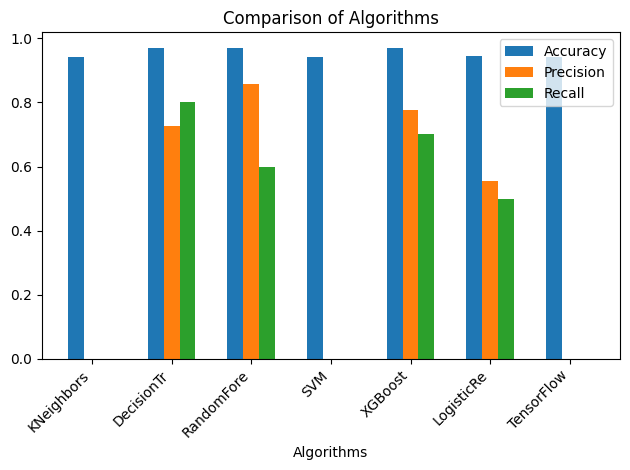

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

algorithms = list(metrics.keys())
accuracies = [metrics[algo]['accuracy'] for algo in algorithms]
precisions = [metrics[algo]['precision'] for algo in algorithms]
recalls = [metrics[algo]['recall'] for algo in algorithms]

x = np.arange(len(algorithms))  # the label locations
width = 0.2  # the width of the bars

fig, ax = plt.subplots()
bars1 = ax.bar(x - width, accuracies, width, label='Accuracy')
bars2 = ax.bar(x, precisions, width, label='Precision')
bars3 = ax.bar(x + width, recalls, width, label='Recall')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_xlabel('Algorithms')
ax.set_title('Comparison of Algorithms')
ax.set_xticks(x)
ax.set_xticklabels([algo[:10] for algo in algorithms], rotation=45, ha='right')
ax.legend()

fig.tight_layout()

plt.show()


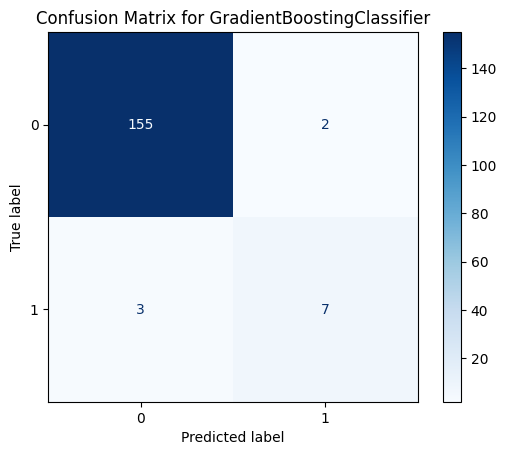

Confusion Matrix:


In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
gbm = GradientBoostingClassifier()
gbm.fit(X_train, y_train)

# Make predictions
y_pred = gbm.predict(X_test)

# Calculate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Display the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=gbm.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix for GradientBoostingClassifier')
plt.show()

# Optionally print the confusion matrix
print("Confusion Matrix:")

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step  


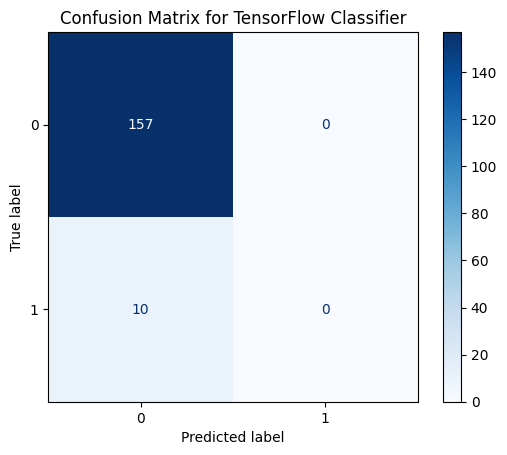

Confusion Matrix:
[[157   0]
 [ 10   0]]


In [ ]:
y_pred_probs = model.predict(X_test)
y_pred = (y_pred_probs > 0.5).astype(int)  # Convert probabilities to binary class labels

# Calculate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Display the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix for TensorFlow Classifier')
plt.show()

# Optionally print the confusion matrix
print("Confusion Matrix:")
print(cm)

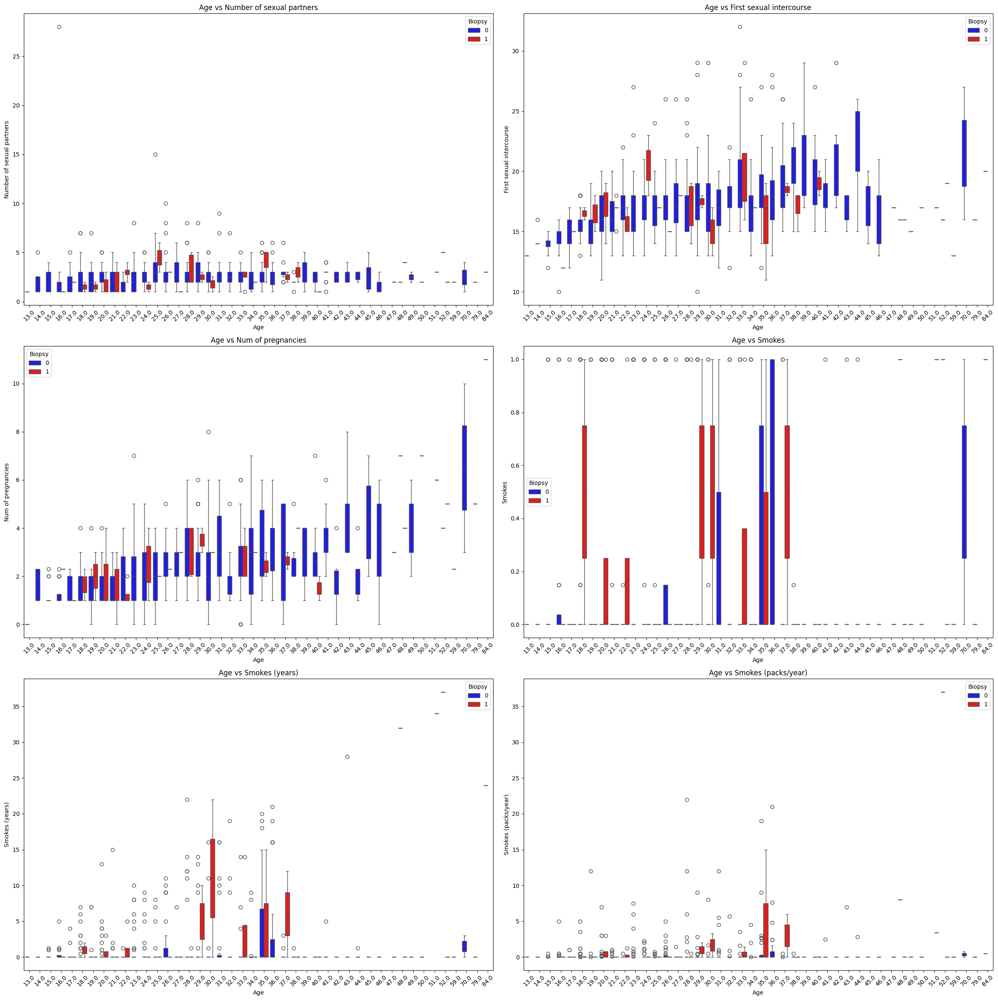

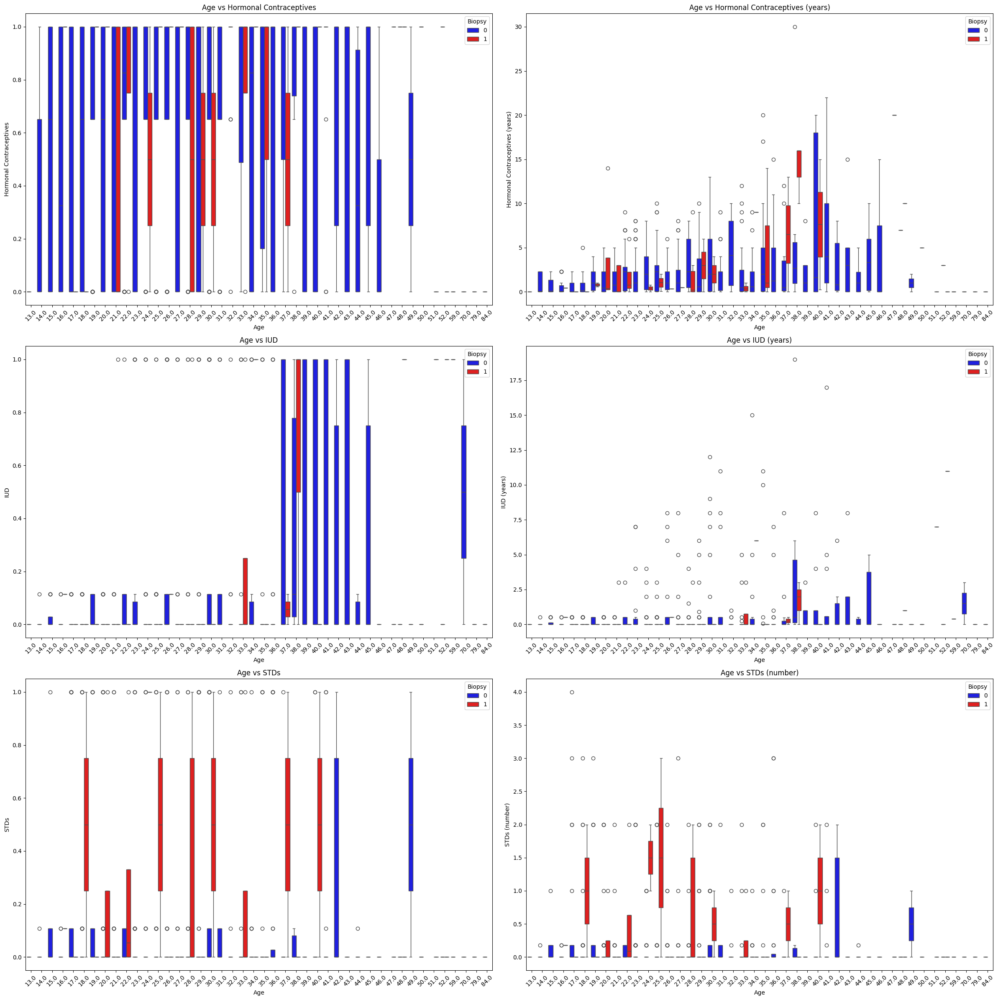

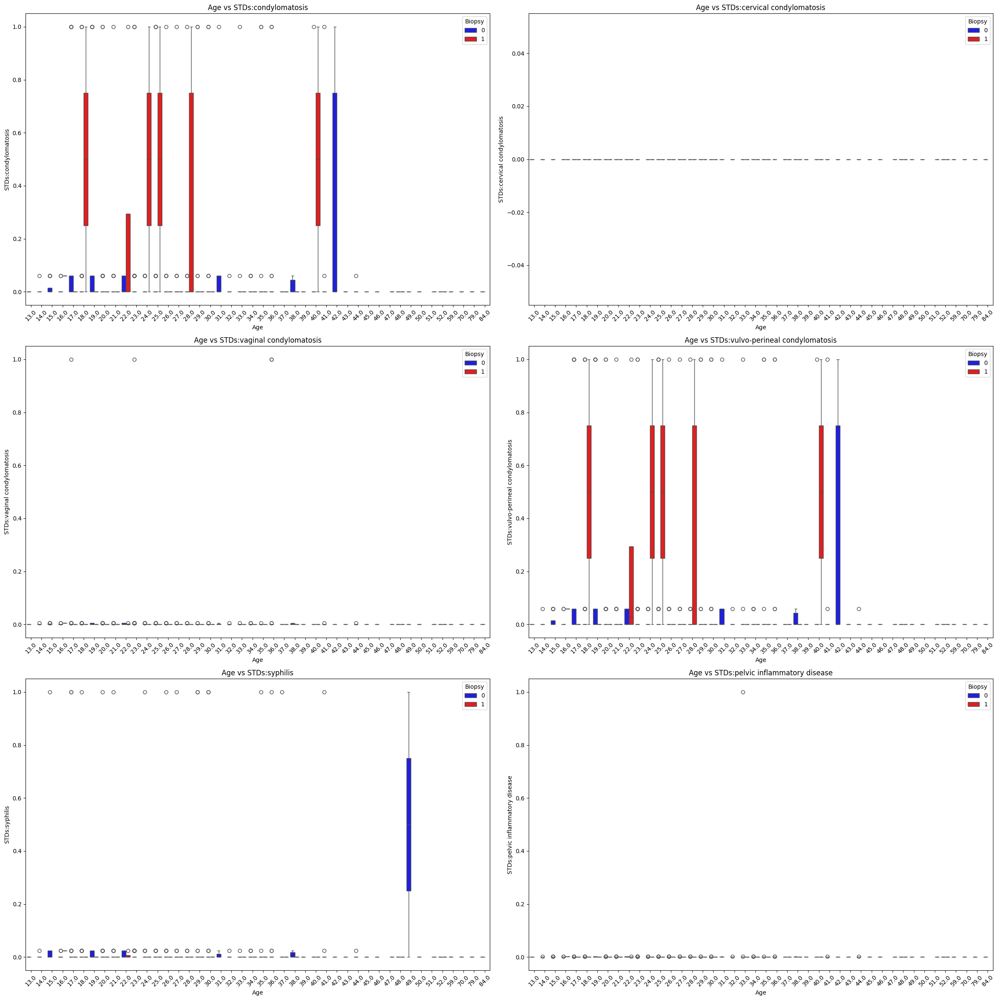

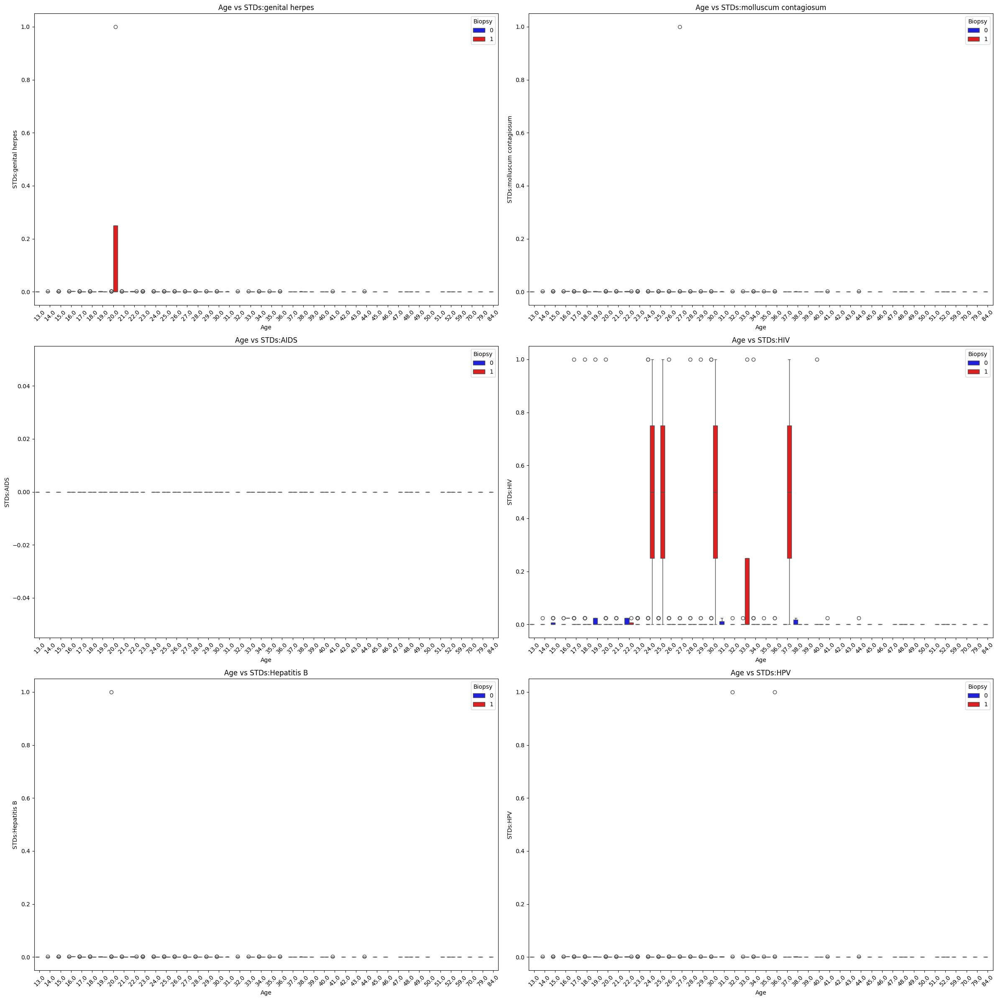

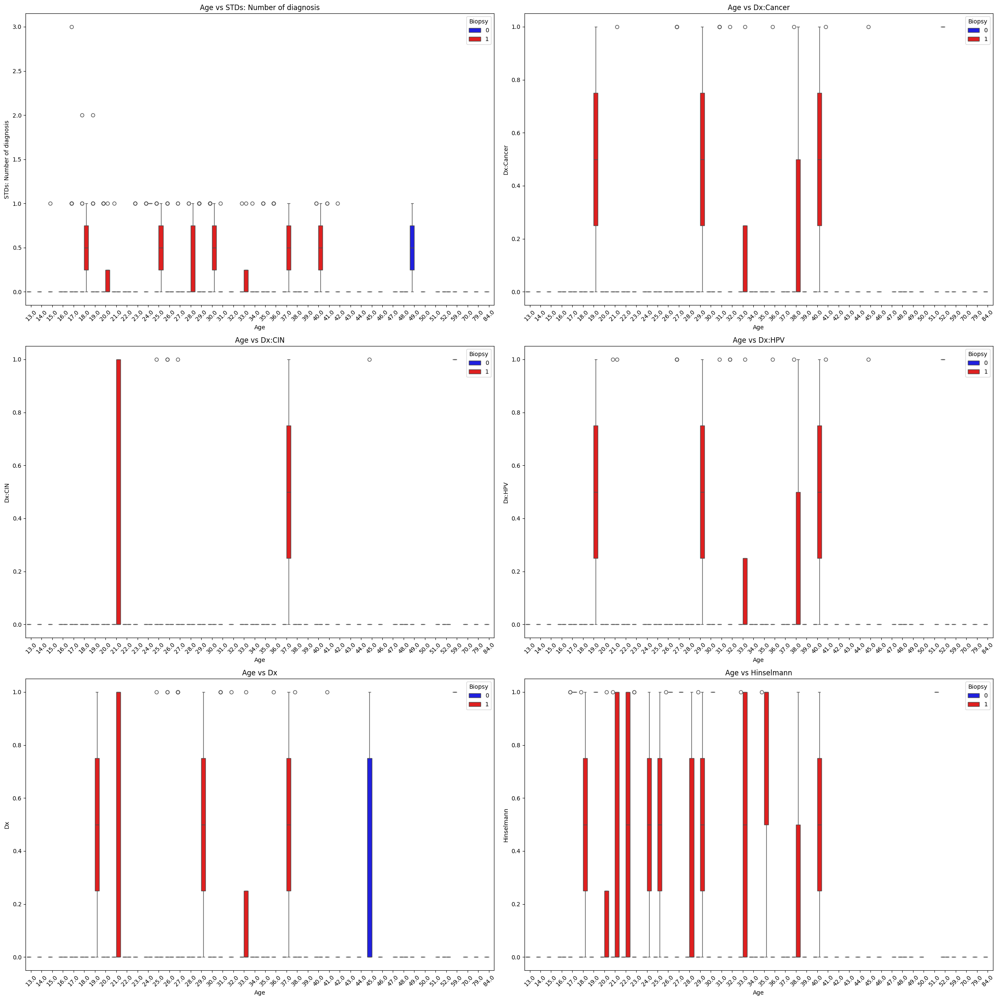

...

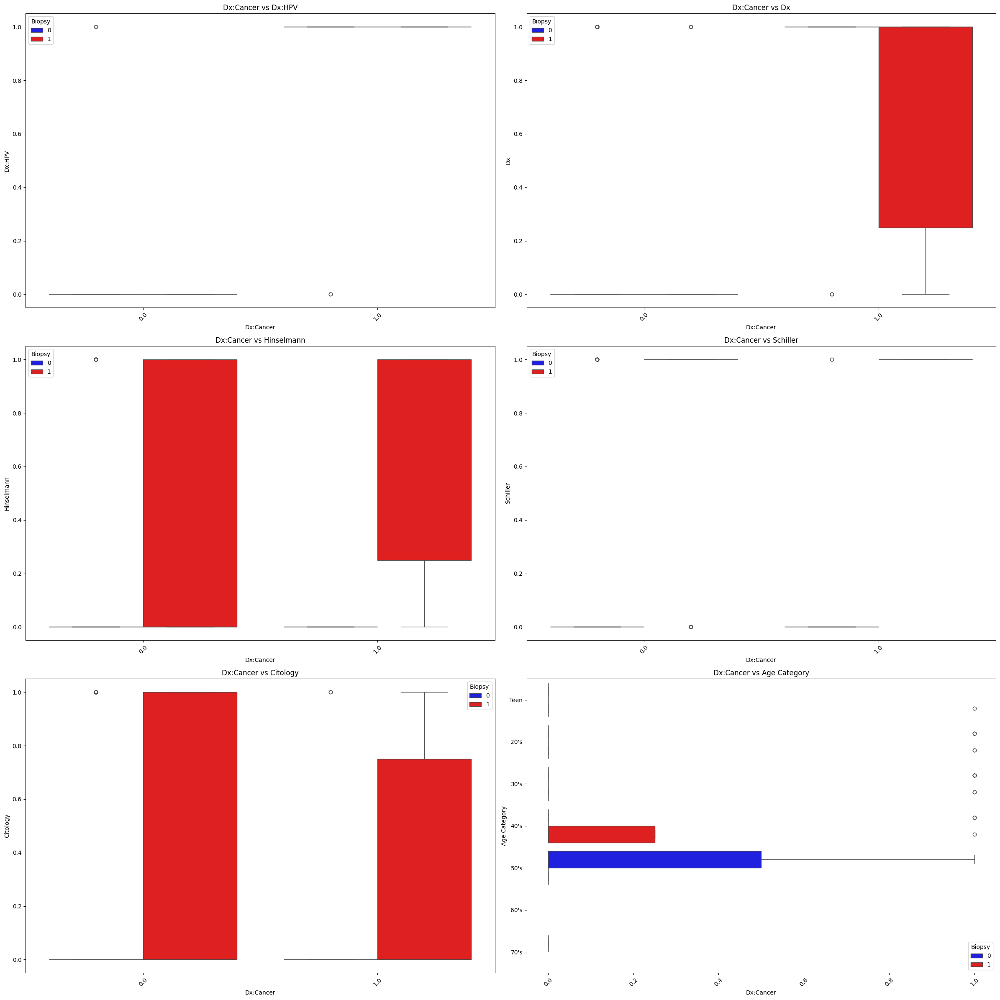

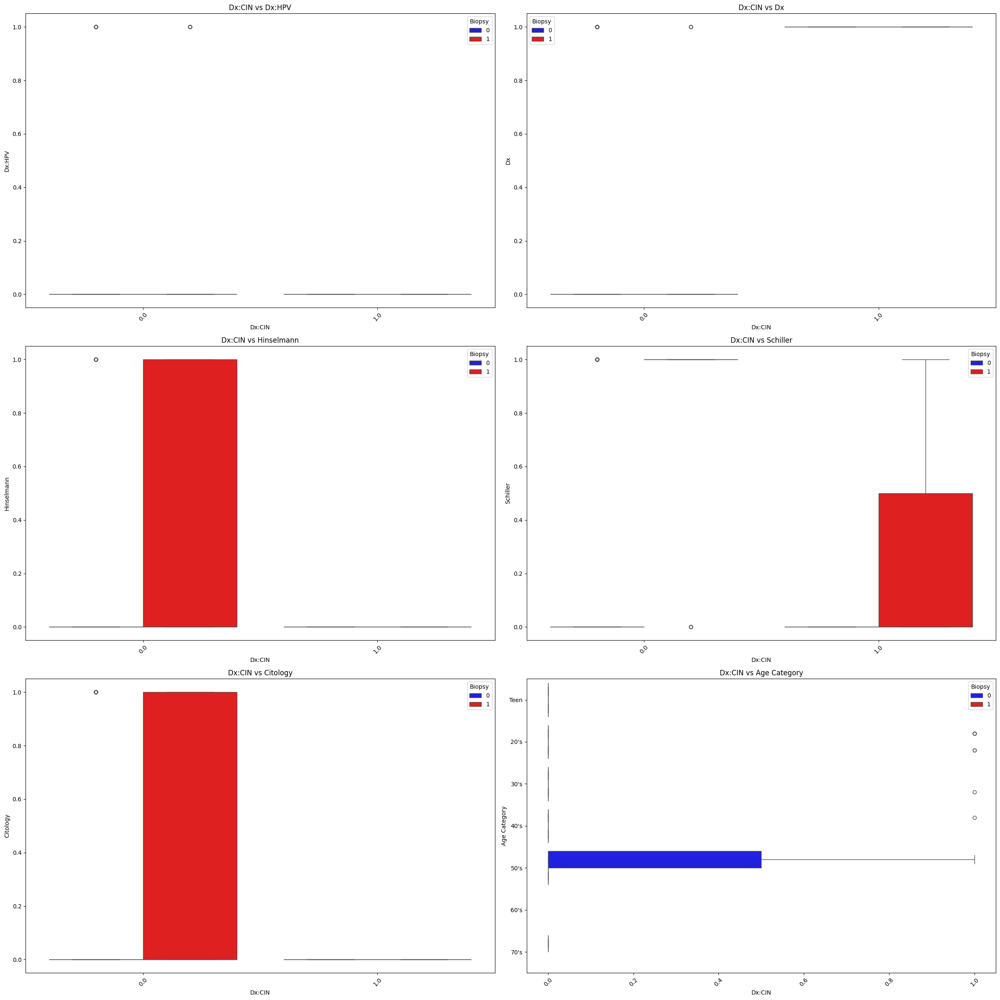

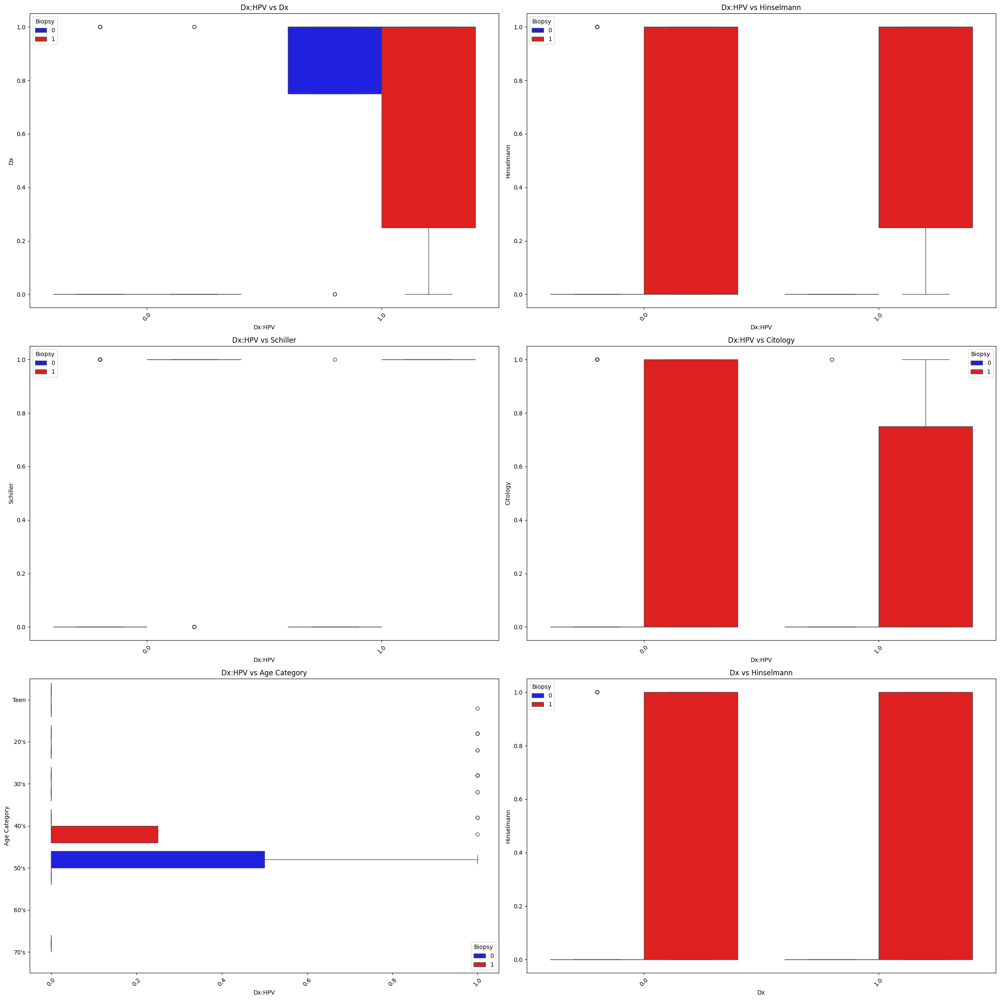

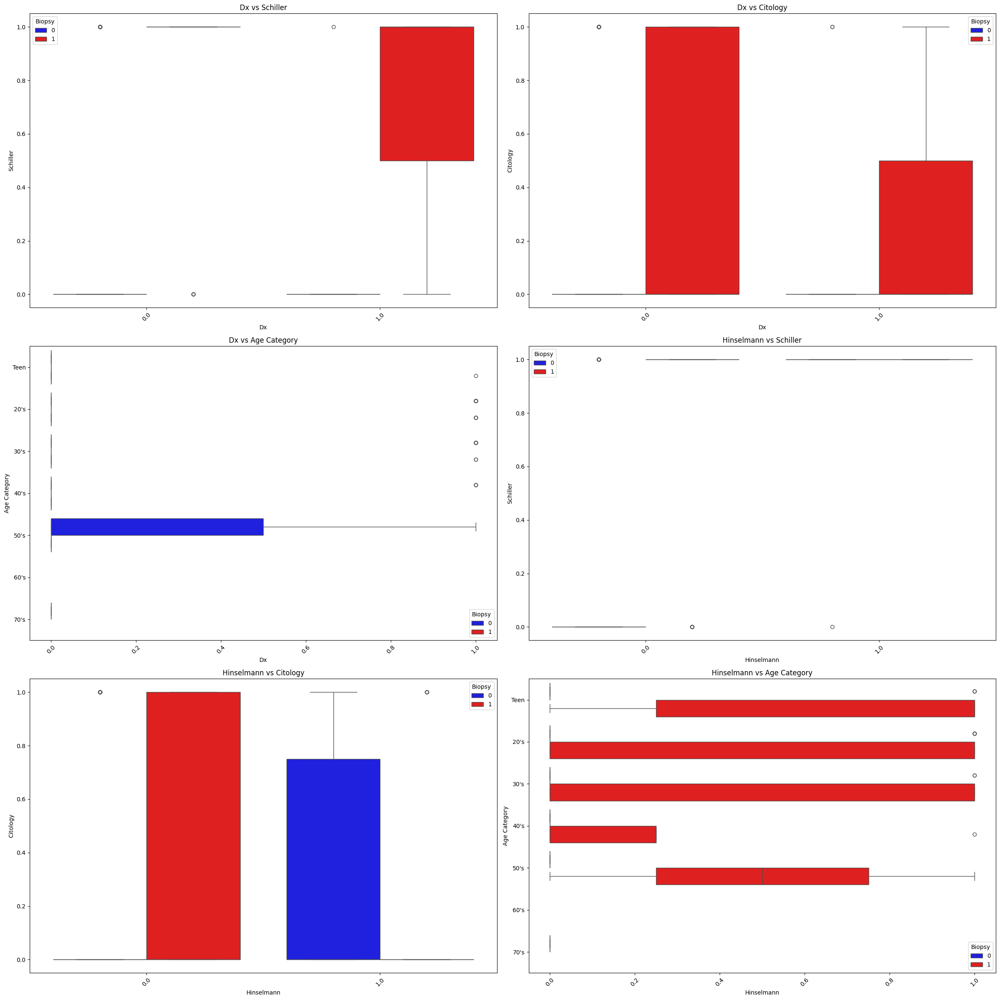

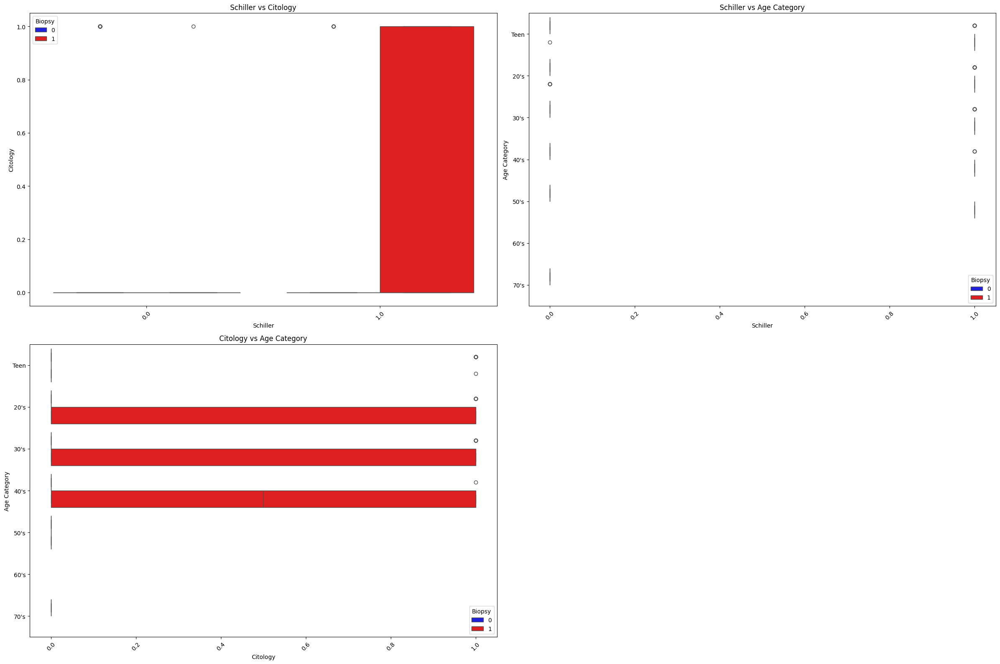

In [241]:
target_col = 'Biopsy'

# Create a list of features (excluding the target column)
features = [col for col in df.columns if col != target_col]

# Number of feature pairs to plot at once
batch_size = 6

# Function to plot a batch of feature pairs
def plot_feature_pairs(features, df, target_col, batch_size, batch_index):
    start = batch_size * batch_index
    end = start + batch_size
    feature_pairs = [(features[i], features[j]) for i in range(len(features)) for j in range(i + 1, len(features))][start:end]

    num_pairs = len(feature_pairs)
    num_cols = 2  # Number of columns in the grid
    num_rows = (num_pairs + num_cols - 1) // num_cols  # Calculate number of rows needed

    # Adjust figure size to be more manageable
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 12, num_rows * 8))

    # Flatten the axes array for easy indexing
    axes = axes.flatten()

    # Plot each feature pair against the target column
    for i, (x_feature, y_feature) in enumerate(feature_pairs):
        sns.boxplot(x=x_feature, y=y_feature, hue=target_col, data=df, palette={0: 'blue', 1: 'red'}, ax=axes[i])
        axes[i].set_title(f'{x_feature} vs {y_feature}')
        axes[i].set_xlabel(x_feature)
        axes[i].set_ylabel(y_feature)
        axes[i].tick_params(axis='x', rotation=45, labelsize=10)  # Rotate x-axis labels

    # Turn off any unused subplots
    for j in range(num_pairs, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

# Plot feature pairs in batches
num_batches = (len(features) * (len(features) - 1) // 2 + batch_size - 1) // batch_size
for batch_index in range(num_batches):
    plot_feature_pairs(features, df, target_col, batch_size, batch_index)

d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer t

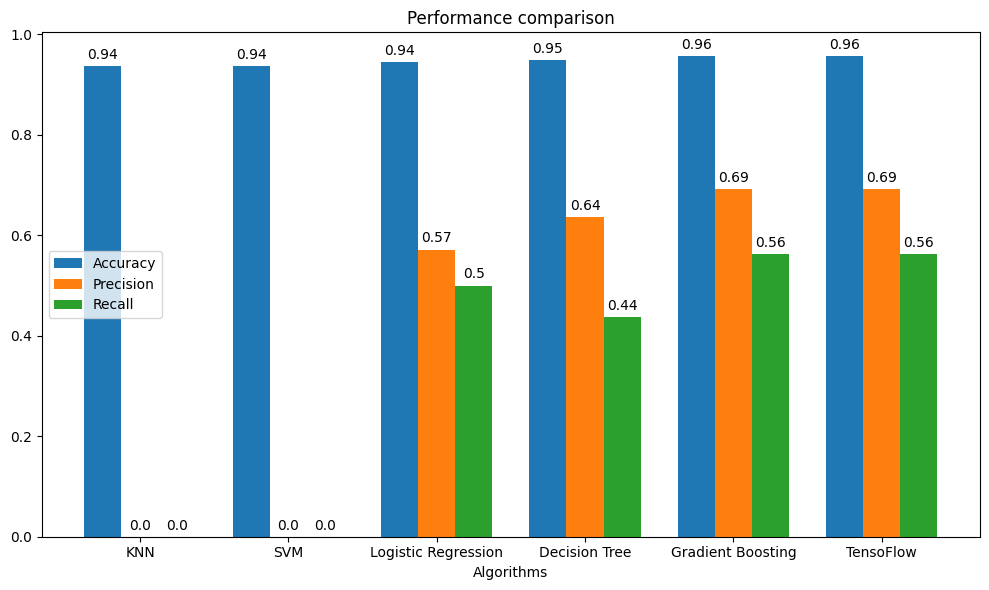

In [64]:


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the classifiers
models = {
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(),
    "Logistic Regression": LogisticRegression(),
    "Decision Tree": DecisionTreeClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "TensoFlow":model
}

# Dictionaries to store metrics
accuracies = {}
precisions = {}
recalls = {}

# Train and evaluate each model
for name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)
    # Predict on the test set
    y_pred = model.predict(X_test)
    # Calculate metrics
    accuracies[name] = accuracy_score(y_test, y_pred)
    precisions[name] = precision_score(y_test, y_pred)
    recalls[name] = recall_score(y_test, y_pred)

# Plotting the performance differences
labels = models.keys()
accuracy_values = list(accuracies.values())
precision_values = list(precisions.values())
recall_values = list(recalls.values())

x = np.arange(len(labels))  # the label locations
width = 0.25  # the width of the bars

fig, ax = plt.subplots(figsize=(10, 6))
rects1 = ax.bar(x - width, accuracy_values, width, label='Accuracy')
rects2 = ax.bar(x, precision_values, width, label='Precision')
rects3 = ax.bar(x + width, recall_values, width, label='Recall')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_xlabel('Algorithms')
ax.set_title('Performance comparison')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

# Function to autolabel bars
def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(round(height, 2)),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)
autolabel(rects3)

fig.tight_layout()

plt.show()

d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


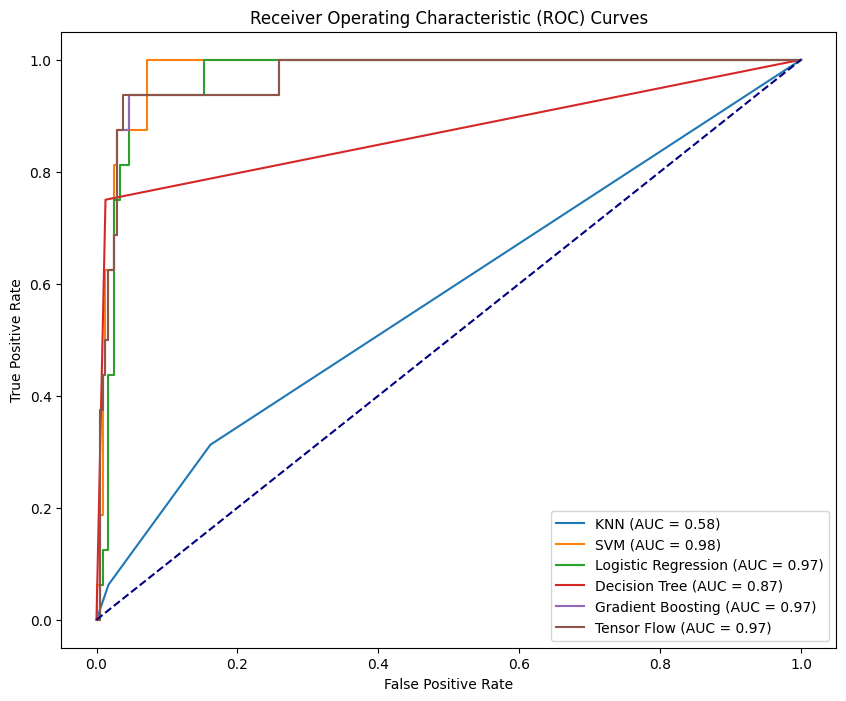

In [66]:
# Import necessary libraries
from sklearn.metrics import roc_curve, auc
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize
import numpy as np

# Sample data and target

# Binarize the output for multi-class (if necessary)
# y_bin = label_binarize(y, classes=[0, 1]) if len(np.unique(y)) > 2 else y

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the classifiers
models = {
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "Logistic Regression": LogisticRegression(),
    "Decision Tree": DecisionTreeClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Tensor Flow":model
    # Add TensorFlow model here if available
}

# Initialize a figure for the ROC curves
plt.figure(figsize=(10, 8))

# Loop over classifiers and plot ROC curve
for name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)
    # Predict probabilities
    if hasattr(model, "predict_proba"):
        y_proba = model.predict_proba(X_test)[:, 1]  # Use the probability of the positive class
    else:  # For models that don't have predict_proba, use decision function
        y_proba = model.decision_function(X_test)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(y_test, y_proba)
    roc_auc = auc(fpr, tpr)
    
    # Plot ROC curve
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.2f})')

# Plotting the ROC curve for random guessing (diagonal line)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')

# Axis labels and title
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curves')
plt.legend(loc="lower right")

# Show plot
plt.show()


d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


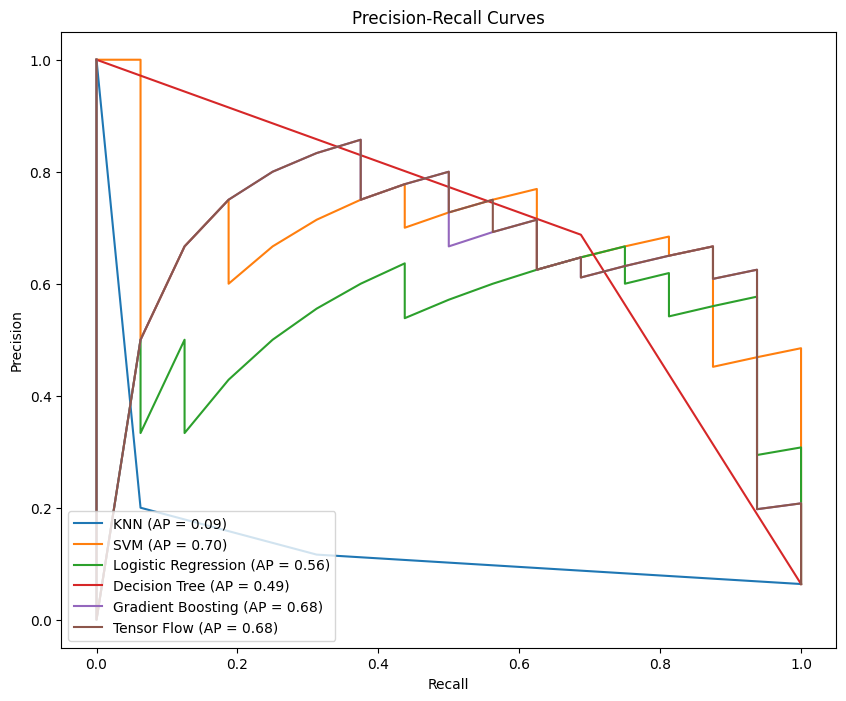

In [68]:
# Import necessary libraries
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import numpy as np

# Sample data and target (replace with your actual data)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the classifiers
models = {
    "KNN": KNeighborsClassifier(),
    "SVM": SVC(probability=True),
    "Logistic Regression": LogisticRegression(),
    "Decision Tree": DecisionTreeClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
     "Tensor Flow":model
}

# Initialize a figure for the Precision-Recall curves
plt.figure(figsize=(10, 8))

# Loop over classifiers and plot Precision-Recall curve
for name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)
    # Predict probabilities
    if hasattr(model, "predict_proba"):
        y_proba = model.predict_proba(X_test)[:, 1]  # Use the probability of the positive class
    else:  # For models that don't have predict_proba, use decision function
        y_proba = model.decision_function(X_test)
    
    # Compute Precision-Recall curve and average precision
    precision, recall, _ = precision_recall_curve(y_test, y_proba)
    avg_precision = average_precision_score(y_test, y_proba)
    
    # Plot Precision-Recall curve
    plt.plot(recall, precision, label=f'{name} (AP = {avg_precision:.2f})')

# Axis labels and title
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curves')
plt.legend(loc="lower left")

# Show plot
plt.show()


d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 38, number of negative: 546
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 219
[LightGBM] [Info] Number of data points in the train set: 584, number of used features: 27
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.065068 -> initscore=-2.665033
[LightGBM] [Info] Start training from score -2.665033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

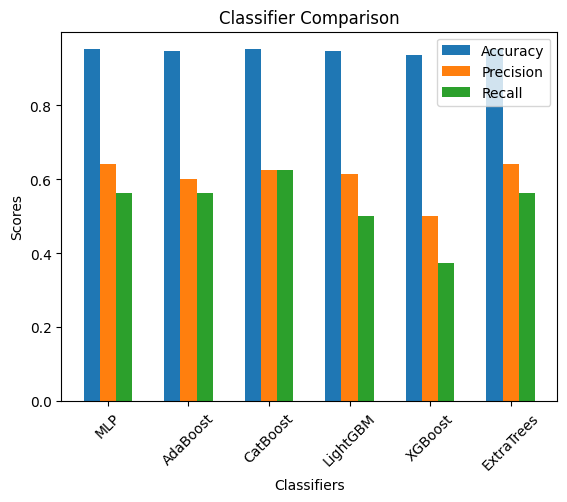

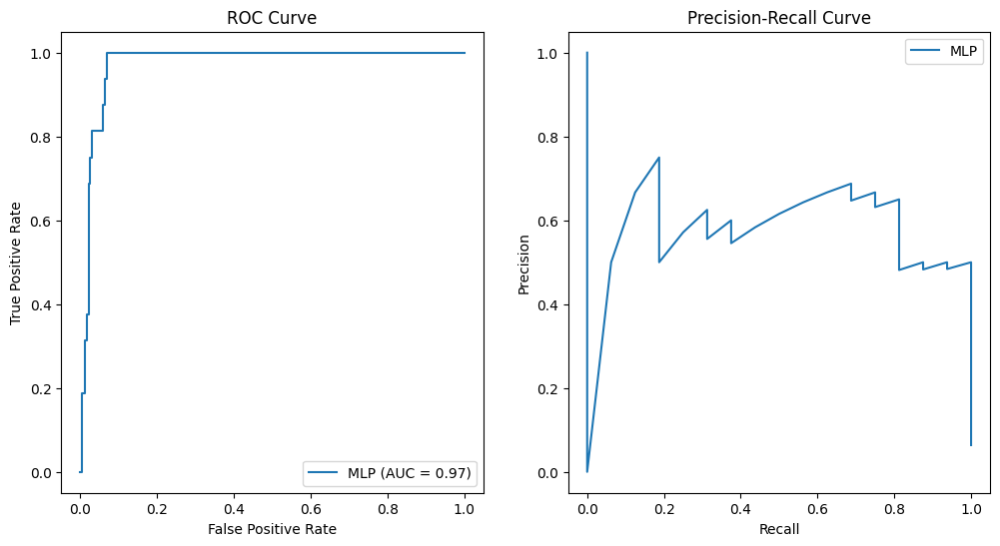

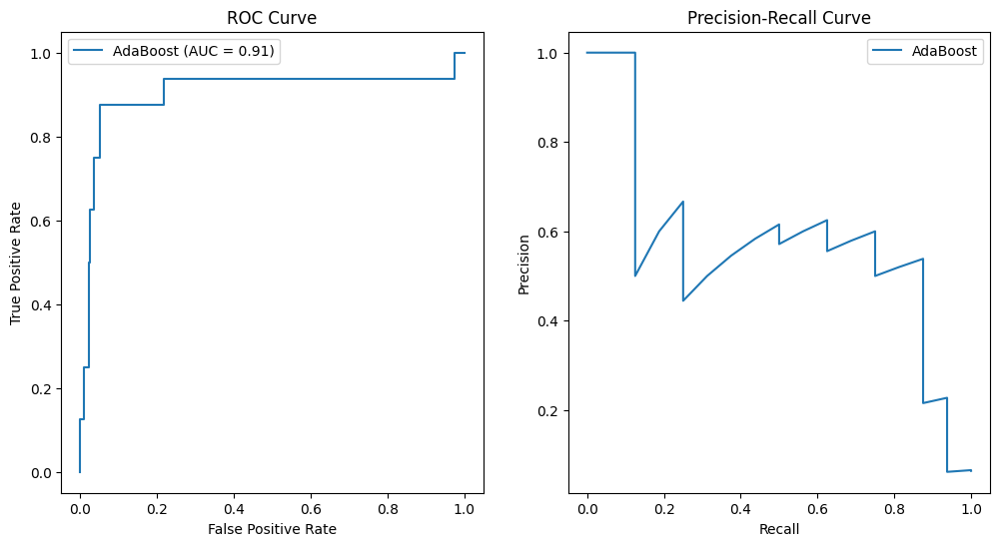

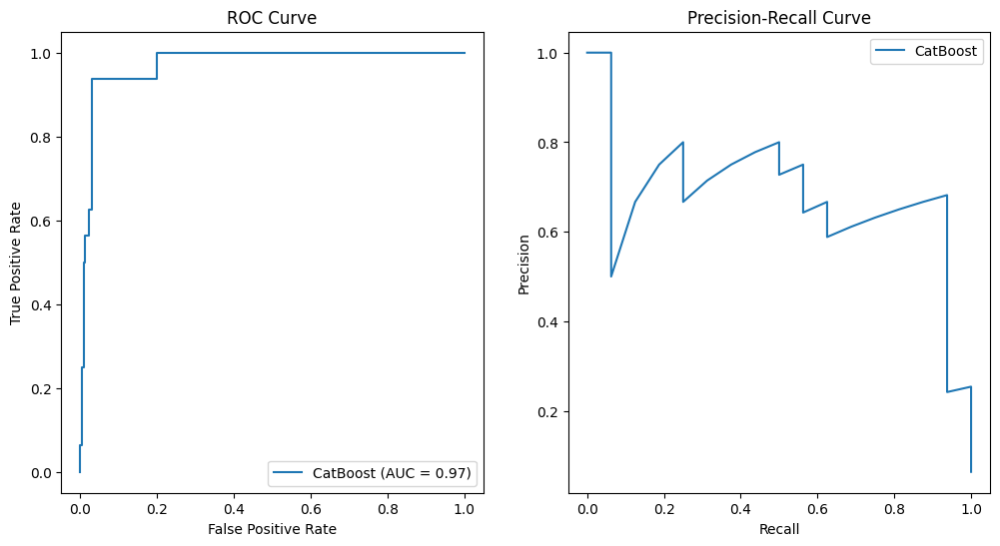

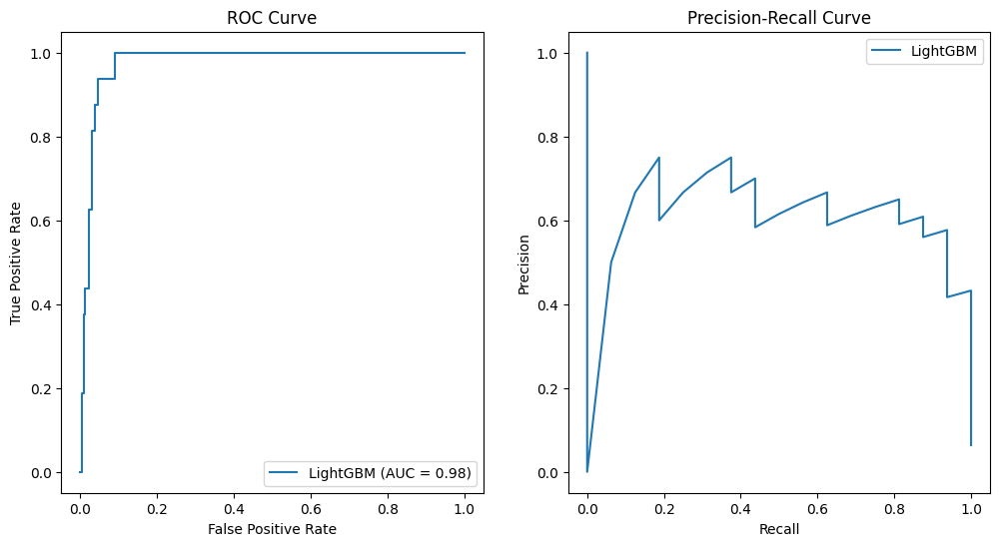

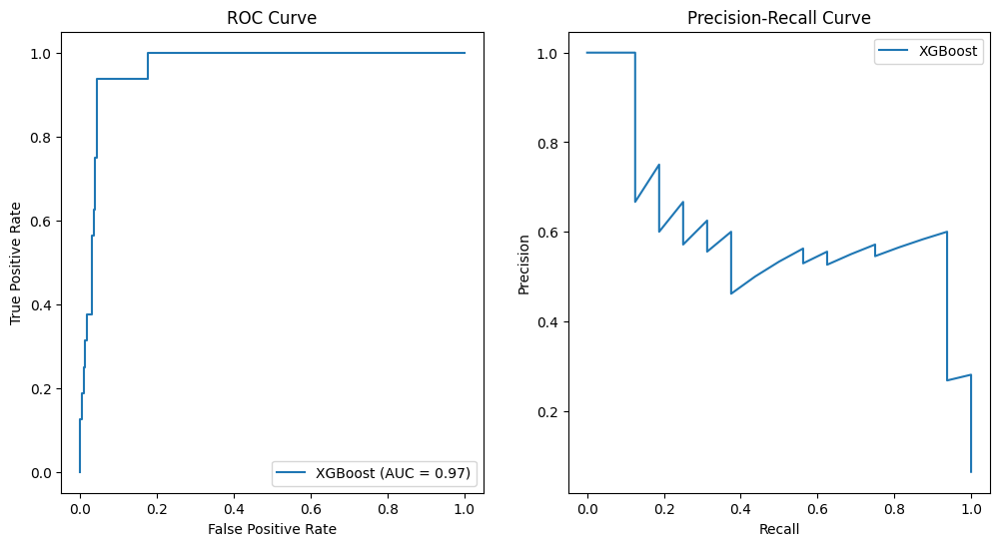

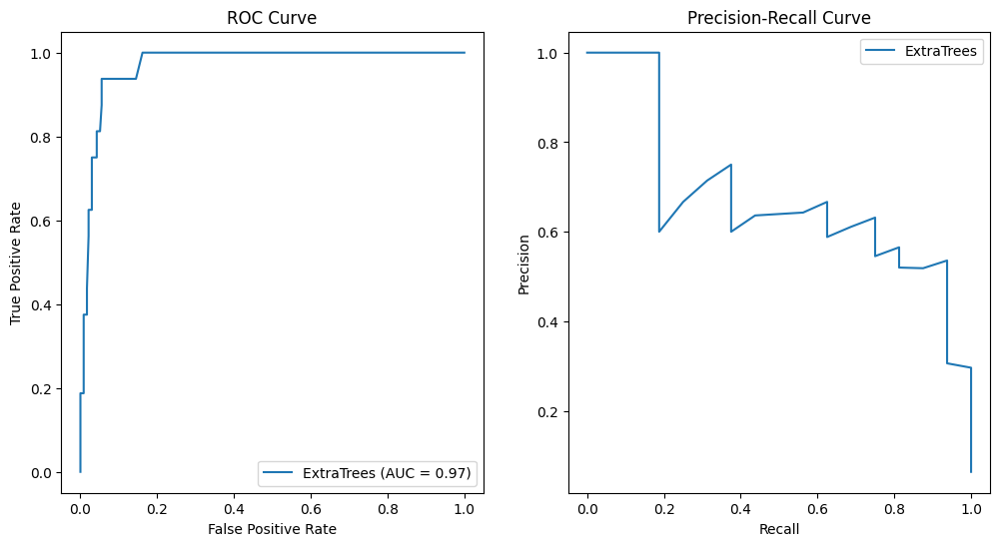

In [71]:
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import AdaBoostClassifier, ExtraTreesClassifier
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score, roc_curve, precision_recall_curve
import matplotlib.pyplot as plt
import numpy as np
def sanitize_feature_names(df):
    df.columns = [col.replace(':', '_').replace('"', '').replace("'", '') for col in df.columns]
    return df

# Sanitize feature names
X_train = sanitize_feature_names(X_train)
X_test = sanitize_feature_names(X_test)
classifiers = {
    'MLP': MLPClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'CatBoost': CatBoostClassifier(verbose=0),
    'LightGBM': LGBMClassifier(),
    'XGBoost': XGBClassifier(),
    'ExtraTrees': ExtraTreesClassifier(),
    # Add STACKB and STACKC accordingly
}

results = {}

for name, clf in classifiers.items():
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    
    results[name] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall
    }

names = list(results.keys())
accuracies = [results[name]['accuracy'] for name in names]
precisions = [results[name]['precision'] for name in names]
recalls = [results[name]['recall'] for name in names]

x = np.arange(len(names))

fig, ax = plt.subplots()
ax.bar(x - 0.2, accuracies, 0.2, label='Accuracy')
ax.bar(x, precisions, 0.2, label='Precision')
ax.bar(x + 0.2, recalls, 0.2, label='Recall')

ax.set_xlabel('Classifiers')
ax.set_ylabel('Scores')
ax.set_title('Classifier Comparison')
ax.set_xticks(x)
ax.set_xticklabels(names, rotation=45)
ax.legend()

plt.show()


for name, clf in classifiers.items():
    y_probs = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_probs)
    precision, recall, _ = precision_recall_curve(y_test, y_probs)
    
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc_score(y_test, y_probs):.2f})')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(recall, precision, label=f'{name}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend()

    plt.show()


d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
d:\Projects\Python\ML\cervical\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logisti

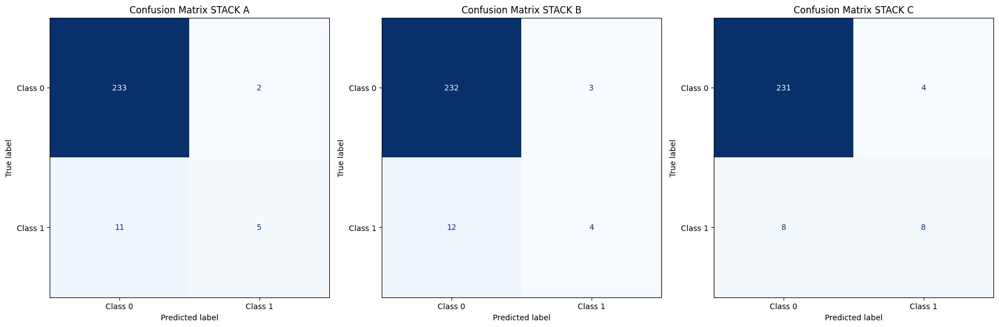

In [73]:
from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

# Define base models
base_models = [
    ('logreg', LogisticRegression()),
    ('svc', SVC(probability=True)),
    ('dt', DecisionTreeClassifier()),
    ('knn', KNeighborsClassifier())
]

# Define the final estimator
final_estimator = LogisticRegression()

# Define stacking classifiers
stacking_A = StackingClassifier(estimators=base_models, final_estimator=final_estimator, cv=5)
stacking_B = StackingClassifier(estimators=base_models, final_estimator=final_estimator, cv=10)
stacking_C = StackingClassifier(estimators=base_models, final_estimator=final_estimator, cv=3)


from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Train and evaluate STACK A
stacking_A.fit(X_train, y_train)
y_pred_A = stacking_A.predict(X_test)

# Train and evaluate STACK B
stacking_B.fit(X_train, y_train)
y_pred_B = stacking_B.predict(X_test)

# Train and evaluate STACK C
stacking_C.fit(X_train, y_train)
y_pred_C = stacking_C.predict(X_test)



# Compute confusion matrices
cm_A = confusion_matrix(y_test, y_pred_A)
cm_B = confusion_matrix(y_test, y_pred_B)
cm_C = confusion_matrix(y_test, y_pred_C)

# Plot confusion matrices
fig, ax = plt.subplots(1, 3, figsize=(18, 6))

# Plot confusion matrix for STACK A
disp_A = ConfusionMatrixDisplay(confusion_matrix=cm_A, display_labels=['Class 0', 'Class 1'])
disp_A.plot(ax=ax[0], cmap='Blues', colorbar=False)
ax[0].set_title('Confusion Matrix STACK A')

# Plot confusion matrix for STACK B
disp_B = ConfusionMatrixDisplay(confusion_matrix=cm_B, display_labels=['Class 0', 'Class 1'])
disp_B.plot(ax=ax[1], cmap='Blues', colorbar=False)
ax[1].set_title('Confusion Matrix STACK B')

# Plot confusion matrix for STACK C
disp_C = ConfusionMatrixDisplay(confusion_matrix=cm_C, display_labels=['Class 0', 'Class 1'])
disp_C.plot(ax=ax[2], cmap='Blues', colorbar=False)
ax[2].set_title('Confusion Matrix STACK C')

plt.tight_layout()
plt.show()



Using 105 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 45/45 [00:01<00:00, 35.15it/s]


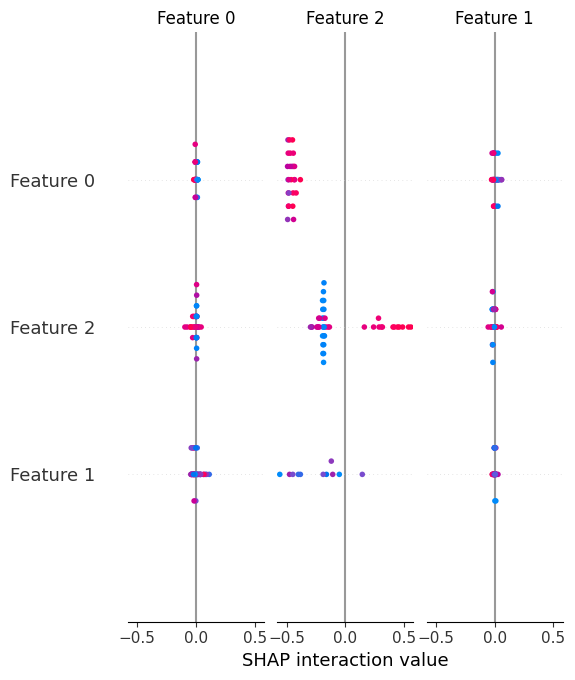

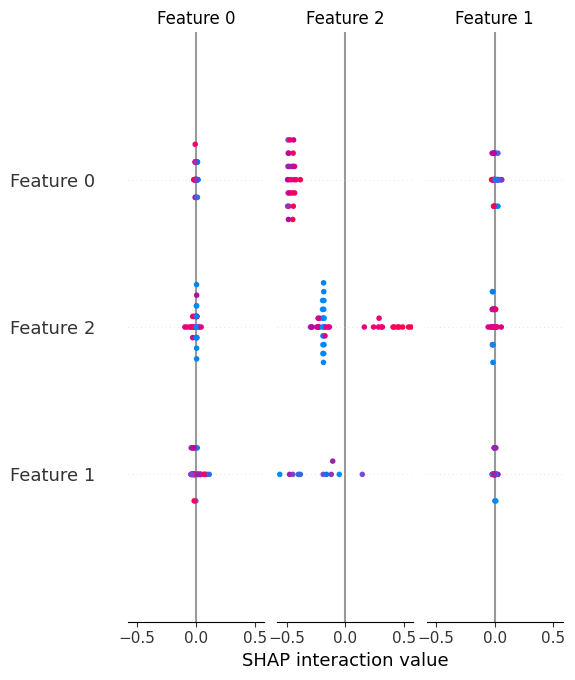

In [79]:
import shap
import matplotlib.pyplot as plt
from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split

# Load dataset and split


# Define and train stacking model
base_models = [
    ('logreg', LogisticRegression(max_iter=1000)),
    ('svc', SVC(probability=True)),
    ('dt', DecisionTreeClassifier()),
    ('knn', KNeighborsClassifier())
]

final_estimator = LogisticRegression()
stacking_model = StackingClassifier(estimators=base_models, final_estimator=final_estimator, cv=5)
stacking_model.fit(X_train, y_train)

# Compute SHAP values
explainer = shap.KernelExplainer(stacking_model.predict_proba, X_train)
shap_values = explainer.shap_values(X_test)

# Plot SHAP values
shap.summary_plot(shap_values, X_test, plot_type="bee")  # Bee swarm plot
shap.summary_plot(shap_values, X_test, plot_type="bar")  # Mean SHAP values


Result ['Age', 'Number of sexual partners', 'First sexual intercourse', 'Num of pregnancies', 'Smokes', 'Smokes (years)', 'Smokes (packs/year)', 'Hormonal Contraceptives', 'Hormonal Contraceptives (years)', 'IUD', 'IUD (years)', 'STDs', 'STDs (number)', 'STDs:condylomatosis', 'STDs:cervical condylomatosis', 'STDs:vaginal condylomatosis', 'STDs:vulvo-perineal condylomatosis', 'STDs:syphilis', 'STDs:pelvic inflammatory disease', 'STDs:genital herpes', 'STDs:molluscum contagiosum', 'STDs:AIDS', 'STDs:HIV', 'STDs:Hepatitis B', 'STDs:HPV', 'STDs: Number of diagnosis', 'STDs: Time since first diagnosis', 'STDs: Time since last diagnosis', 'Dx:Cancer', 'Dx:CIN', 'Dx:HPV', 'Dx', 'Hinselmann', 'Schiller', 'Citology']


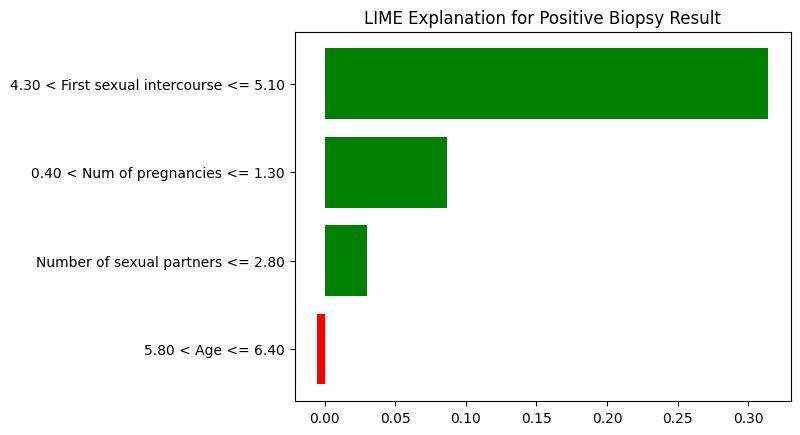

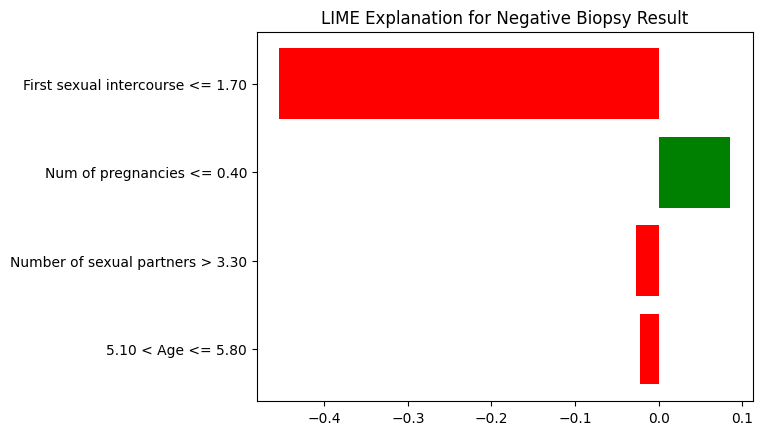

In [97]:
import lime
import lime.lime_tabular
import matplotlib.pyplot as plt

from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split

# Load dataset and split

# Define and train stacking model
base_models = [
    ('logreg', LogisticRegression(max_iter=1000)),
    ('svc', SVC(probability=True)),
    ('dt', DecisionTreeClassifier()),
    ('knn', KNeighborsClassifier())
]

final_estimator = LogisticRegression()
stacking_model = StackingClassifier(estimators=base_models, final_estimator=final_estimator, cv=5)
stacking_model.fit(X_train, y_train)
feature_names = X.columns.tolist()  # List of feature names
class_names = y.unique().astype(str).tolist()  #
print(f"Result {feature_names}")
# Initialize the LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train,
    feature_names=feature_names,
    class_names=class_names,
    mode='classification'
)

# Choose an instance with a positive biopsy result (class 1)
positive_instance = X_test[y_test == 1][0]  # Example instance

# Generate LIME explanation
explanation_positive = explainer.explain_instance(
    data_row=positive_instance,
    predict_fn=stacking_model.predict_proba
)

# Plot LIME explanation
fig = explanation_positive.as_pyplot_figure()
plt.title('LIME Explanation for Positive Biopsy Result')
plt.show()
# Choose an instance with a negative biopsy result (class 0)
negative_instance = X_test[y_test == 0][0]  # Example instance

# Generate LIME explanation
explanation_negative = explainer.explain_instance(
    data_row=negative_instance,
    predict_fn=stacking_model.predict_proba
)

# Plot LIME explanation
fig = explanation_negative.as_pyplot_figure()
plt.title('LIME Explanation for Negative Biopsy Result')
plt.show()
